## Clase 03a: Operaciones Elementales sobre Rasters

------

### Lo que veremos en esta notebook:

- [x]  Aprender (o mejor dicho, repasar) las operaciones básicas de lectura y visualización de archivos raster georreferenciados, extendiéndolo al caso de un raster multibanda.  
- [x]  Aprender a realizar operaciones básicas de procesamiento como el recorte, apilado  y el álgebra de bandas. 
- [x]  Guardar recortes de una imagen original como archivos nuevos.  

### 1) Lectura de rasters georreferenciados

Vamos a trabajar con la imagen SPOT 7 de la ciudad de Córdoba presentada en la clase anterior. Utilizaremos la librería GDAL introducida en la Clase 02 para abrir el archivo, y para luego escribir los resultados obtenidos. Para el tratamiento de los datos utilizaremos la estructura que nos ofrecen los arreglos de NumPy repasadas en las clases anteriores:  


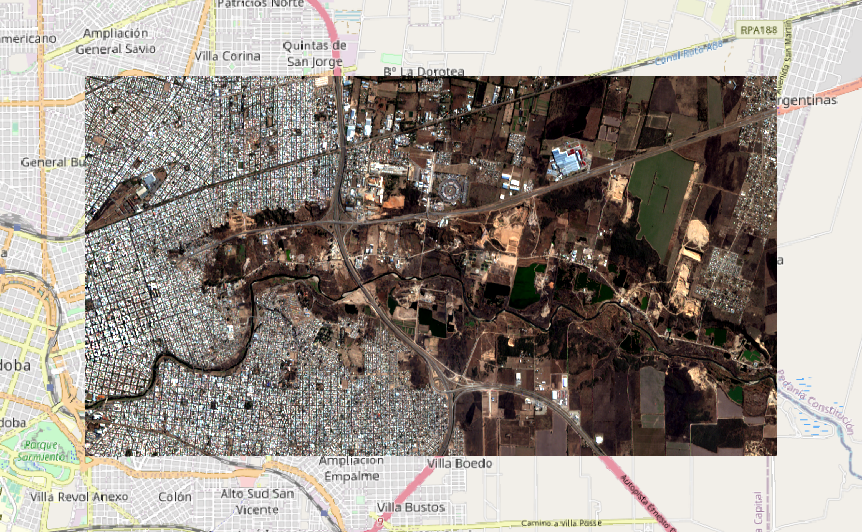

Empecemos por importar las librerías que vamos a utilizar:

```python
import numpy as np
from osgeo import gdal
from matplotlib import pyplot as plt
import sys
sys.path.append('../')

import warnings
warnings.filterwarnings('ignore')
```

In [1]:
import numpy as np
from osgeo import gdal
from matplotlib import pyplot as plt
import sys
sys.path.append('../')

import warnings
warnings.filterwarnings('ignore')

A continuación, miremos nuestros archivos en la carpeta **data/raw_data**. Tenemos dos archivos de extensión **.tif**. Uno corresponde a la banda pancromática de nuestra SPOT, y el otro a un apilado de las 3 bandas del visible + el infrarrojo cercano (NIR) (¿qué resolucion tienen cada uno de estos productos?):  

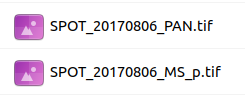   
  

También tenemos dos archivos .XML que corresponden a los metadatos que cada uno de estos productos. Se utilizan en la Notebook 03b, que queda como opcional:  

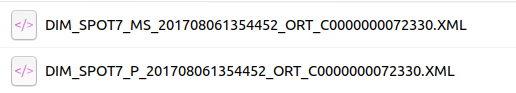  

Empezaremos por leer el archivo **SPOT_20170806_MS_p.tif**. Atención! No confundir este archivo con **SPOT_20170806_MS.tif** . Este último se usa en la Notebook 03b.

En este archivo están apiladas las bandas en el siguiente orden:

- Banda 1: Azul
- Banda 2: Verde
- Banda 3: Rojo
- Banda 4: Infrarrojo cercano

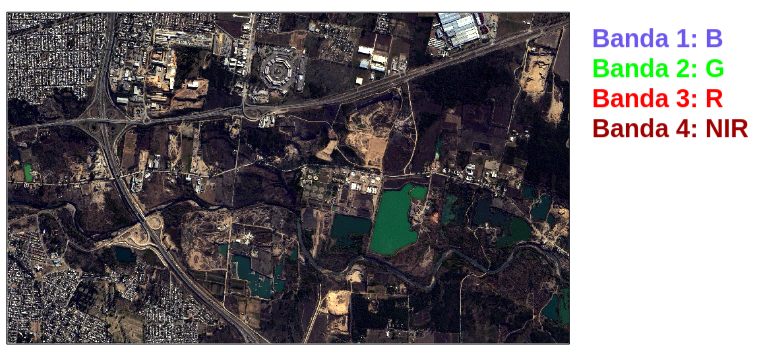


```python
spot_apilada = gdal.Open('../data/raw_data/SPOT_20170806_MS_p.tif')

#Alternativamente, podemos usar la libreria os y la función path.join para evitarnos los problemas de notación
# de directorios entre Windows, Mac y Linux:

# import os
# spot_apilada = gdal.Open(os.path.join('../data/raw_data','SPOT_20170806_MS.tif'))
```

In [2]:
spot_apilada = gdal.Open("./raw_data/SPOT_20170806_MS_p.tif")

La imagen así abierta es solo un objeto de GDAL. Probá ver qué devuelve el print() sobre la variable recién creada:

```python
print(spot_apilada)
```

In [3]:
print(spot_apilada)

<osgeo.gdal.Dataset; proxy of <Swig Object of type 'GDALDatasetShadow *' at 0x000001FA14588E10> >


No podemos hacer mucho con este objeto. Lo convertiremos a matriz de Numpy con el método ReadAsArray() aprendido en la Clase 2, pero antes leeremos sus parámetros GeoTransform y  Projection para utilizarlos más tarde

```python
gt = spot_apilada.GetGeoTransform()
src = spot_apilada.GetProjection()

#Recordar: ¿Qué devuelve el print() sobre estas variables?
```

In [4]:
gt = spot_apilada.GetGeoTransform()
src = spot_apilada.GetProjection()

In [5]:
print(gt)
#Esta función obtiene los parámetros de georreferenciación del raster.
#Devuelve una tupla de 6 elementos que definen cómo traducir coordenadas de píxeles (columna, fila) a coordenadas geográficas (X, Y reales)

(388866.0, 6.0, 0.0, 6528056.0, 0.0, -6.0)


In [6]:
print(src)
#Esta función devuelve la proyección cartográfica del raster como una cadena WKT (Well-Known Text).
#Especifica cómo se interpretan las coordenadas espaciales del raster (por ejemplo, UTM, WGS84, etc.).

PROJCS["WGS 84 / UTM zone 20S",GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4326"]],PROJECTION["Transverse_Mercator"],PARAMETER["latitude_of_origin",0],PARAMETER["central_meridian",-63],PARAMETER["scale_factor",0.9996],PARAMETER["false_easting",500000],PARAMETER["false_northing",10000000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH],AUTHORITY["EPSG","32720"]]


Ahora sí, leemos la imagen como matriz con _ReadAsArray()_:

```python
spot_apilada = spot_apilada.ReadAsArray()
```

In [7]:
spot_apilada = spot_apilada.ReadAsArray()

#### Veamos las dimensiones de esta imagen, ¿Cuántas columnas, filas y bandas tiene?

```python
spot_apilada.shape
```

In [8]:
spot_apilada.shape

(4, 989, 1801)

A diferencia de las imágenes que trabajamos hasta ahora, esta es un arreglo de **3** dimensiones: Número de bandas, filas y columnas.

### Visualización en escala de grises (repaso Clase 02)

```python
banda1 = spot_apilada[0,:,:]
plt.figure(figsize = (12,6))
plt.imshow(banda1, cmap = 'gray')
plt.title("Banda 1 ")
plt.show()
```

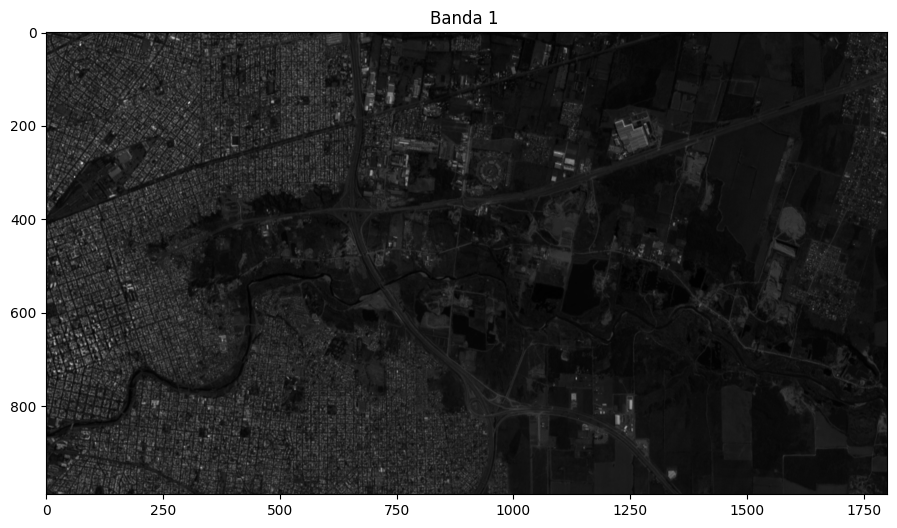

In [9]:
banda1 = spot_apilada[0,:,:]
plt.figure(figsize = (12,6))
plt.imshow(banda1, cmap = 'gray')
plt.title("Banda 1 ")
plt.show()

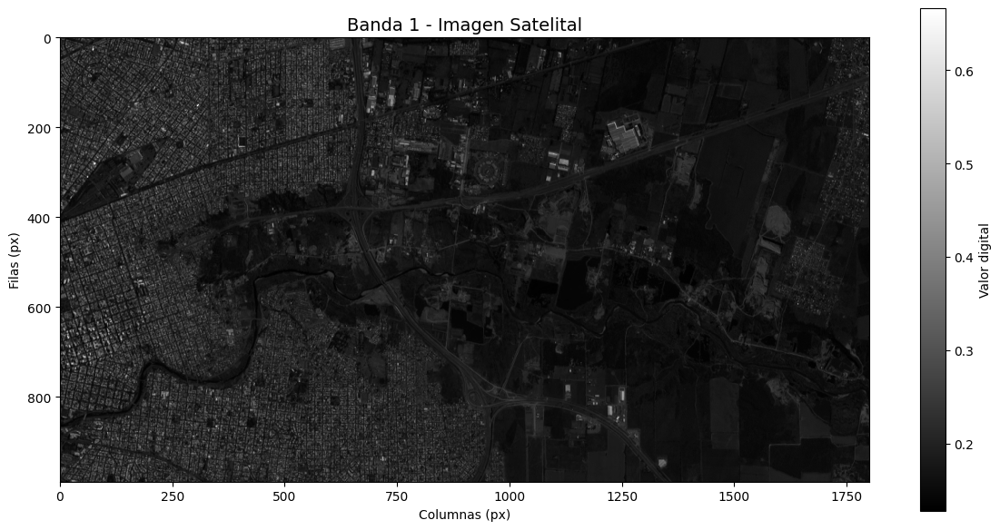

In [10]:
banda1 = spot_apilada[0, :, :]

plt.figure(figsize=(12, 6))
plt.imshow(banda1, cmap='gray', interpolation='none')
plt.title("Banda 1 - Imagen Satelital", fontsize=14)
plt.xlabel("Columnas (px)")
plt.ylabel("Filas (px)")
plt.colorbar(label="Valor digital")
plt.grid(False)
plt.tight_layout()
plt.show()

#### ¿Qué estamos viendo como "coordenadas de esta imagen"?

Hemos leido este archivo como _arreglo_ de Numpy. Las coordenadas que vemos son: En el eje Y, las filas, que crecen desde arriba hacia abajo; y en el eje X las columnas, cuyo índice crece de izquierda a derecha.

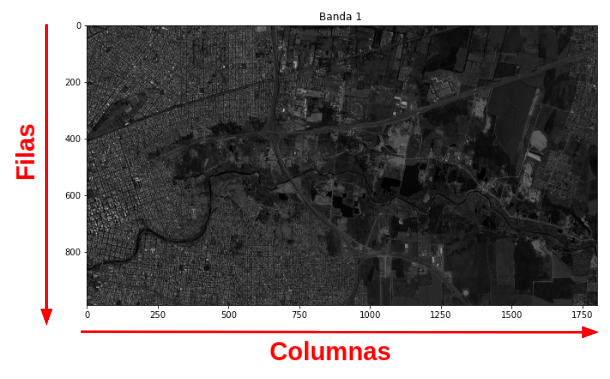


#### ¿Son estas las coordenadas geográficas / cartográficas de la imagen? 
**NO**, no lo son. En la clase 4 veremos cómo con la biblioteca `rasterio` las podemos abrir y visualizar sus coordenadas, pero para lo que resta en esta clase será suficiente con lo que nos ofrece `Numpy`.



#### Obtengamos algunas estadísticas para nuestras bandas. Se muestra un ejemplo con la banda 1

```python
# Leamos algunas estadísticas de cada banda
#Para visualizar cada banda, utilizamos el slicing sobre los arreglos de numpy
# Se muestra el ejemplo para la banda 1. Completar para el resto de las bandas

banda1 = spot_apilada[0,:,:]
# banda2 = spot_apilada[?,:,:]
# banda3 = spot_apilada[?,:,:]
# banda4 = spot_apilada[?,:,:]

#Mínimo y máximo:
min_b1, max_b1 = np.min(banda1), np.max(banda1)

#Percentiles 2% y 98%
p2_b1 = np.percentile(banda1, 2)
p98_b1 = np.percentile(banda1, 98)

print(f'Mínimo:{min_b1}, Máximo:{max_b1}')
print(f'Percentil 2%: {p2_b1}, Percentil 98%: {p98_b1}')
```

In [11]:
banda1 = spot_apilada[0,:,:]
# banda2 = spot_apilada[?,:,:]
# banda3 = spot_apilada[?,:,:]
# banda4 = spot_apilada[?,:,:]

#Mínimo y máximo:
min_b1, max_b1 = np.min(banda1), np.max(banda1)

#Percentiles 2% y 98%
p2_b1 = np.percentile(banda1, 2)
p98_b1 = np.percentile(banda1, 98)

print(f'Mínimo:{min_b1}, Máximo:{max_b1}')
print(f'Percentil 2%: {p2_b1}, Percentil 98%: {p98_b1}')

Mínimo:0.128498837351799, Máximo:0.6661261320114136
Percentil 2%: 0.1421610563993454, Percentil 98%: 0.28653761744499207


#### Veamos cómo se ven gráficamente los percentiles en el histograma de la Banda 1

Para esto podemos usar la librería matplotlib importada al inicio de la notebook.
Una de las funciones que incluye es _hist_ , que permite hacer el hisograma:

```python
plt.figure(figsize = (12,6))
plt.hist(banda1.ravel(), bins = 100)
plt.axvline(p2_b1, color = 'red' ,linestyle = '--', label = 'Percentil 2%')
plt.axvline(p98_b1, color = 'black' ,linestyle = '--', label = 'Percenil 98%')
plt.legend()
plt.title("Histograma Banda 1")
plt.show()
```

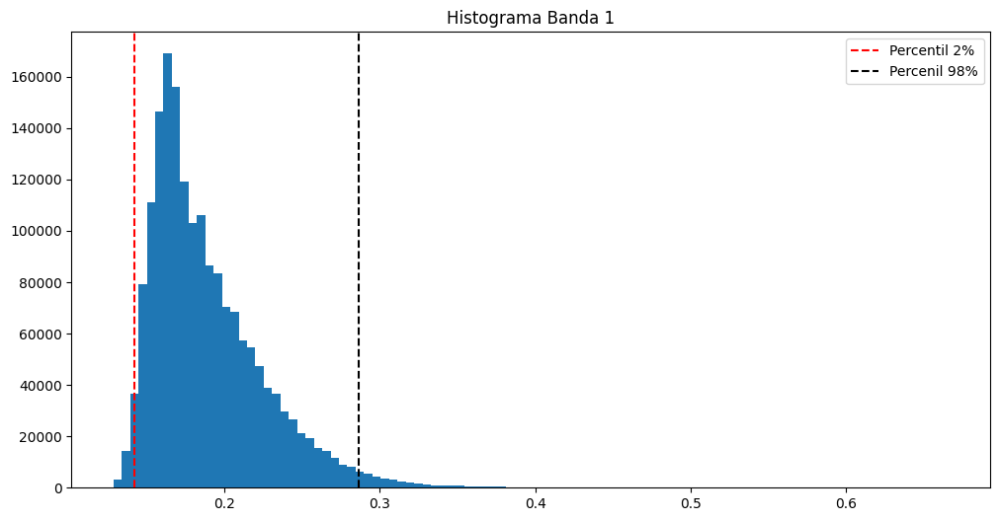

In [12]:
plt.figure(figsize = (12,6))
plt.hist(banda1.ravel(), bins = 100)
plt.axvline(p2_b1, color = 'red' ,linestyle = '--', label = 'Percentil 2%')
plt.axvline(p98_b1, color = 'black' ,linestyle = '--', label = 'Percenil 98%')
plt.legend()
plt.title("Histograma Banda 1")
plt.show()

In [13]:
banda2 = spot_apilada[1,:,:]

#Mínimo y máximo:
min_b2, max_b2 = np.min(banda2), np.max(banda2)

#Percentiles 2% y 98%
p2_b2 = np.percentile(banda2, 2)
p98_b2 = np.percentile(banda2, 98)

print(f'Mínimo:{min_b2}, Máximo:{max_b2}')
print(f'Percentil 2%: {p2_b2}, Percentil 98%: {p98_b2}')

Mínimo:0.08298933506011963, Máximo:0.7293214797973633
Percentil 2%: 0.10690151154994965, Percentil 98%: 0.2844846248626709


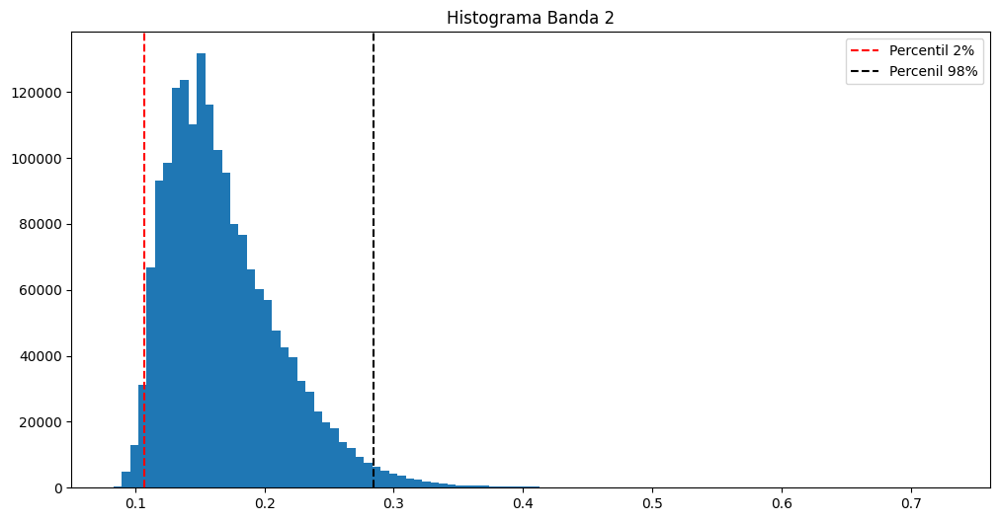

In [14]:
plt.figure(figsize = (12,6))
plt.hist(banda2.ravel(), bins = 100)
plt.axvline(p2_b2, color = 'red' ,linestyle = '--', label = 'Percentil 2%')
plt.axvline(p98_b2, color = 'black' ,linestyle = '--', label = 'Percenil 98%')
plt.legend()
plt.title("Histograma Banda 2")
plt.show()

In [15]:
banda3 = spot_apilada[2,:,:]
# banda2 = spot_apilada[?,:,:]
# banda3 = spot_apilada[?,:,:]
# banda4 = spot_apilada[?,:,:]

#Mínimo y máximo:
min_b3, max_b3 = np.min(banda3), np.max(banda3)

#Percentiles 2% y 98%
p2_b3 = np.percentile(banda3, 2)
p98_b3 = np.percentile(banda3, 98)

print(f'Mínimo:{min_b3}, Máximo:{max_b3}')
print(f'Percentil 2%: {p2_b3}, Percentil 98%: {p98_b3}')

Mínimo:0.05307960510253906, Máximo:0.7650386095046997
Percentil 2%: 0.08154258131980896, Percentil 98%: 0.3050154149532318


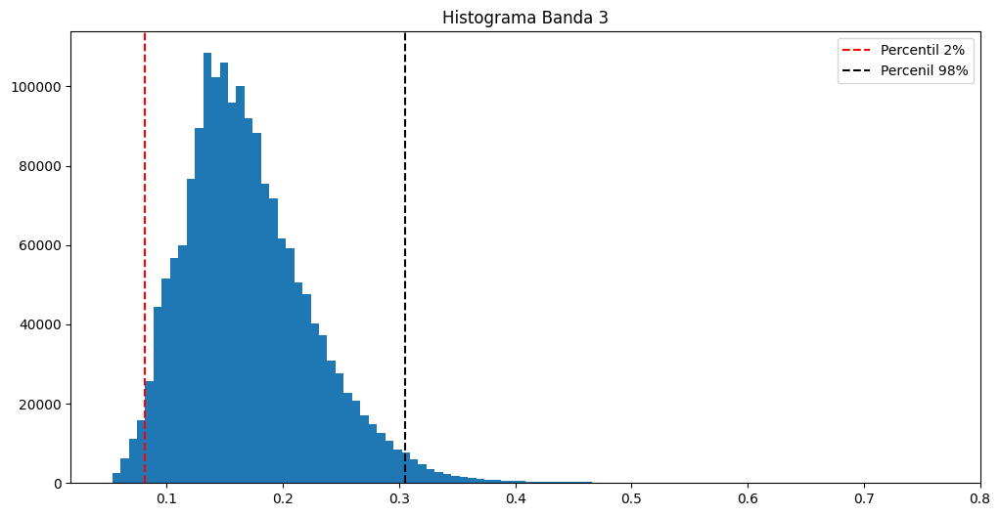

In [16]:
plt.figure(figsize = (12,6))
plt.hist(banda3.ravel(), bins = 100)
plt.axvline(p2_b3, color = 'red' ,linestyle = '--', label = 'Percentil 2%')
plt.axvline(p98_b3, color = 'black' ,linestyle = '--', label = 'Percenil 98%')
plt.legend()
plt.title("Histograma Banda 3")
plt.show()

In [17]:
banda4 = spot_apilada[3,:,:]
# banda2 = spot_apilada[?,:,:]
# banda3 = spot_apilada[?,:,:]
# banda4 = spot_apilada[?,:,:]

#Mínimo y máximo:
min_b4, max_b4 = np.min(banda4), np.max(banda4)

#Percentiles 2% y 98%
p2_b4 = np.percentile(banda4, 2)
p98_b4 = np.percentile(banda4, 98)

print(f'Mínimo:{min_b4}, Máximo:{max_b4}')
print(f'Percentil 2%: {p2_b4}, Percentil 98%: {p98_b4}')

Mínimo:0.03528347611427307, Máximo:0.8072431683540344
Percentil 2%: 0.08446650952100754, Percentil 98%: 0.34820160269737244


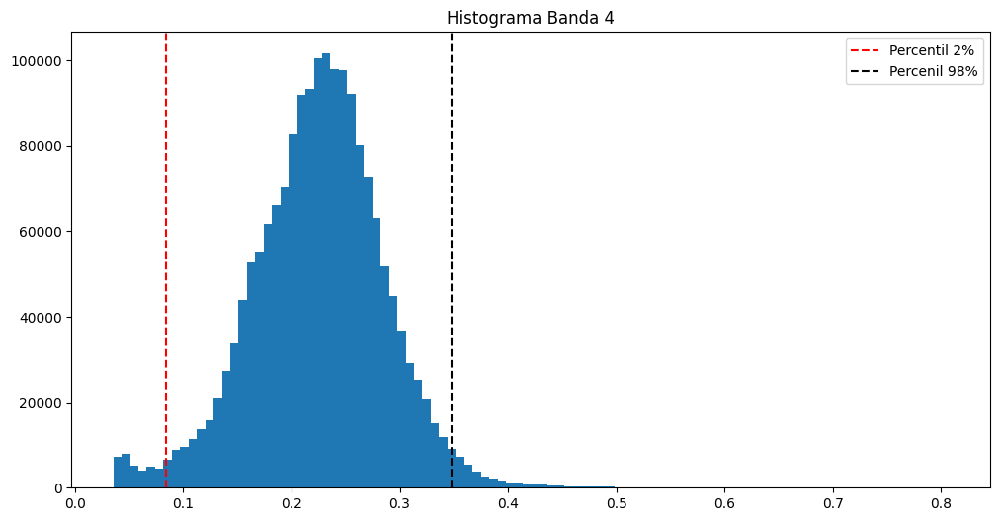

In [18]:
plt.figure(figsize = (12,6))
plt.hist(banda4.ravel(), bins = 100)
plt.axvline(p2_b4, color = 'red' ,linestyle = '--', label = 'Percentil 2%')
plt.axvline(p98_b4, color = 'black' ,linestyle = '--', label = 'Percenil 98%')
plt.legend()
plt.title("Histograma Banda 4")
plt.show()

**Pregunta (de repaso): ¿Porqué en el comando _plt.hist_ agregamos el operador _.ravel()_ ?**

Convertir una imagen (matriz 2D) en un vector 1D de píxeles.

Hacer que plt.hist() pueda construir el histograma correctamente.

Visualizar la distribución de valores de todos los píxeles de la banda.

#### Ahora visualizamos la banda 1 con distintas opciones de escalado, aplicando la función scale() que armaste en la Clase 02. Atención a cómo la estamos importando y usando en las siguientes celdas:

```python
import funciones as fn

fig, ax = plt.subplots(2, 1, figsize = (30,15))
#Estirando al min/max de la imagen
ax[0].imshow(banda1, cmap = 'gray')
ax[0].set_title("Banda 1 - Mínimo Máximo")

#Estirando al 2% - 98% de la imagen
ax[1].imshow(fn.scale(banda1, p = 10), cmap = 'gray')
ax[1].set_title("Banda 1 - 5% / 95%")
plt.show()
```

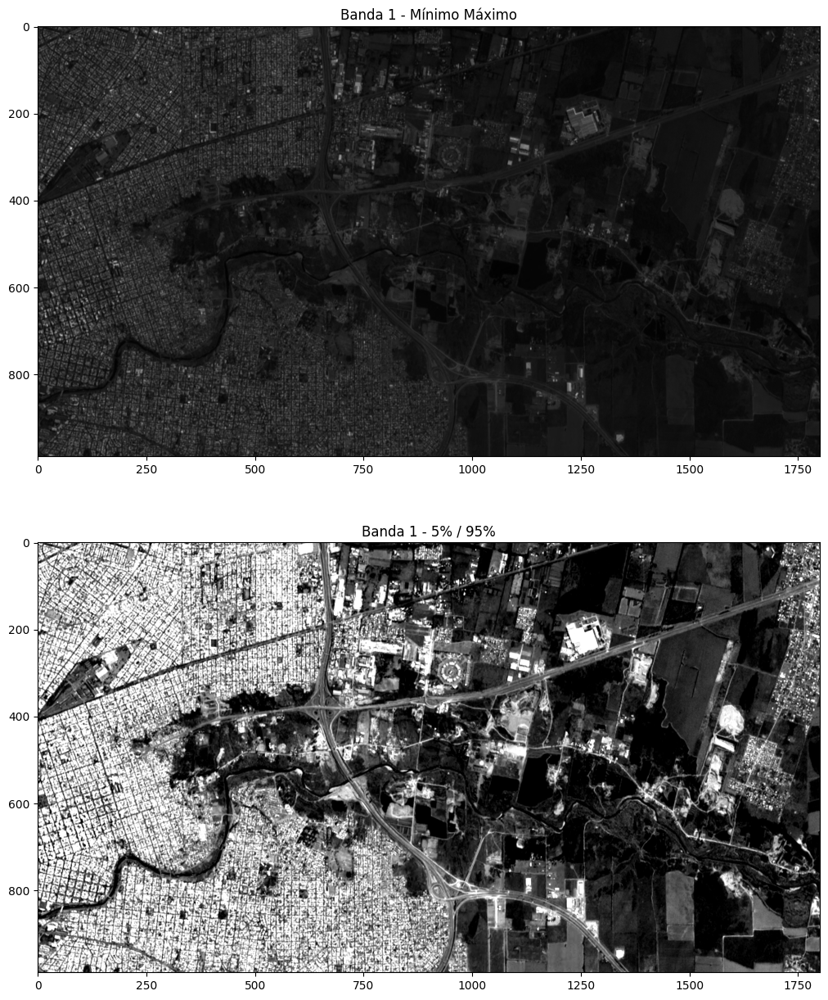

In [19]:
import funciones as fn

fig, ax = plt.subplots(2, 1, figsize = (30,15))

#Estirando al min/max de la imagen
ax[0].imshow(banda1, cmap = 'gray')
ax[0].set_title("Banda 1 - Mínimo Máximo")

#Estirando al 2% - 98% de la imagen
ax[1].imshow(fn.scale(banda1, p = 10), cmap = 'gray')
ax[1].set_title("Banda 1 - 5% / 95%")
plt.show()

¿Qué pasa si abrimos una de las bandas de la imagen MODIS vista en la clase 02b, y le aplicamos la función **scale()** tal cual como quedó definida?

```python
# Definamos la imagen a utilizar:
img = '../data/raw_data/MOD09A1.A2000049.h11v08.006.2015136143404.hdf'
image = gdal.Open(img)
subdatasets = image.GetSubDatasets()
del image
# Definamos la imagen a utilizar:
img = '../data/raw_data/MOD09A1.A2000049.h11v08.006.2015136143404.hdf'
image = gdal.Open(img)
subdatasets = image.GetSubDatasets()
del image

import pandas as pd
pd.options.display.max_colwidth=77
df = pd.DataFrame(subdatasets, columns=['image', 'description'])

# Busquemos la información de nuestras bandas de interés:
b01 = df.loc[df['description'].str.contains('b01'), 'image']
b01 = gdal.Open(b01[0])
b01 = b01.ReadAsArray()
```

In [20]:
# Definamos la imagen a utilizar:
import pandas as pd

img = './raw_data/MOD09A1.A2000049.h11v08.006.2015136143404.hdf'
image = gdal.Open(img)
subdatasets = image.GetSubDatasets()
del image

pd.options.display.max_colwidth=77

df = pd.DataFrame(subdatasets, columns=['image', 'description'])

# Busquemos la información de nuestras bandas de interés:
b01 = df.loc[df['description'].str.contains('b01'), 'image']
b01 = gdal.Open(b01[0])
b01 = b01.ReadAsArray()

El problema que tiene la función **scale()**  es con el valor de los píxeles en la zona negra de la imagen, a los cuales la función está considerando para hacer el estiramiento:

```python
#Estirando al 2% - 98% de la imagen
plt.figure(figsize = (12,6))
plt.title("Banda 1 - 5% / 95%")
plt.imshow(fn.scale(b01, p = 5), cmap = 'gray')
plt.show()
```

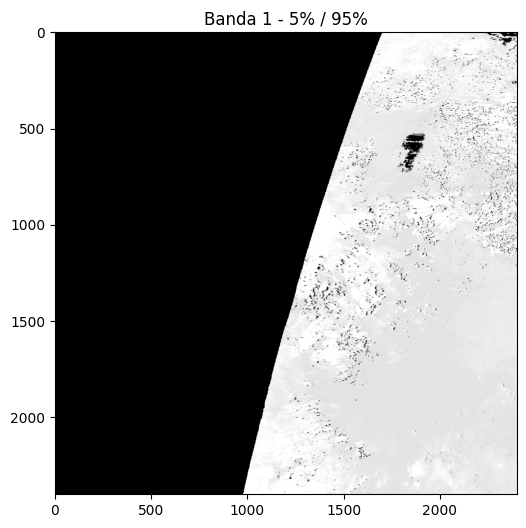

In [21]:
#Estirando al 2% - 98% de la imagen
plt.figure(figsize = (12,6))
plt.title("Banda 1 - 5% / 95%")
plt.imshow(fn.scale(b01, p = 5), cmap = 'gray')
plt.show()

Esos valores de la zona negra de la imagen en realidad deberían ser considerados como _nodata_!! Una manera de individualizar ese valor es buscar el mínimo de las bandas originales:


```python
print(f'Valor mínimo de la banda 01: {b01.min()}')
```

In [22]:
print(f'Valor mínimo de la banda 01: {b01.min()}')

Valor mínimo de la banda 01: -28672


Sin embargo, algo mucho más correcto sería poder leer como un metadato de la imagen de entrada, el valor que está asignado como _nodata_. Eso lo podemos hacer sobre el _dataset_ de GDAL con el método _GetNoDataValue_:

```python
b1 = df.loc[df['description'].str.contains('b01'), 'image']
b1 = gdal.Open(b1[0])
ndata = b1.GetRasterBand(1).GetNoDataValue()
print(f'Valor NoData de la banda 01: {ndata}')

#Borramos b1, ya no la volvemos a usar
del b1
```

In [23]:
b1 = df.loc[df['description'].str.contains('b01'), 'image']
b1 = gdal.Open(b1[0])
ndata = b1.GetRasterBand(1).GetNoDataValue()
print(f'Valor NoData de la banda 01: {ndata}')

#Borramos b1, ya no la volvemos a usar
del b1

Valor NoData de la banda 01: -28672.0


Vamos a hacerle una modificación a la función **scale** para incluir un valor que sea considerado _nodata_ y sea excluido en el cálculo de los percentiles (no olvides correr la celda para que quede re-definida!):

```python
def scale(array,p = 0, nodata = None):
    '''
    Esta función escala o estira la imagen a determinado % del histograma (trabaja con percentiles)
    Si p = 0 (valor por defecto) entonces toma el mínimo y máximo de la imagen.
    Devuelve un arreglo nuevo, escalado de 0 a 1
    '''
    a = array.copy()
    a_min, a_max = np.percentile(a[a!=nodata],p), np.percentile(a[a!=nodata],100-p)
    a[a<a_min]=a_min
    a[a>a_max]=a_max
    return ((a - a_min)/(a_max - a_min))
```

In [24]:
# Función redefinida


Ahora volvemos a probar el ploteo usando como parámetro el valor que leimos en la variable `ndata`:

```python
#Estirando al 2% - 98% de la imagen
plt.figure(figsize = (12,6))
plt.title("Banda 1 - 5% / 95%")
plt.imshow(scale(b01, p = 5, nodata = ndata), cmap = 'gray')
plt.show()
```

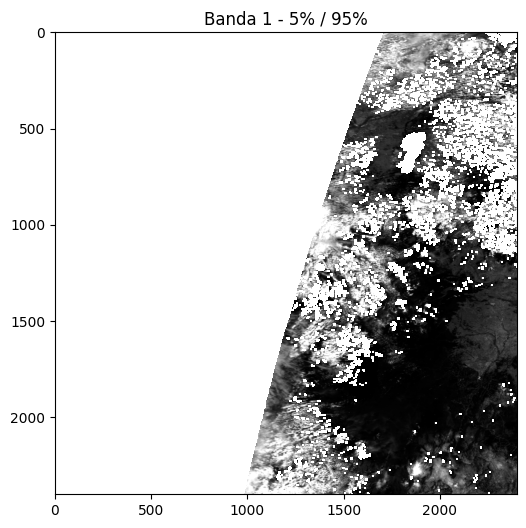

In [26]:
#Estirando al 2% - 98% de la imagen
plt.figure(figsize = (12,6))
plt.title("Banda 1 - 5% / 95%")
plt.imshow(fn.scale(b01, p = 5, nodata = ndata), cmap = 'gray')
plt.show()

¡Esto ya se ve mucho mejor! Guardá esta nueva versión de **scale** en tu archivo de funciones. Aprovechamos para hacer una aclaración importante: A veces, cuando trabajas en Juypter Notebooks, para que esta modificacion impacte en tu archivo de funciones, tenés que **reiniciar el kernel y volver a importar las funciones**. De lo contrario, seguirás usando la versión vieja de **scale**:



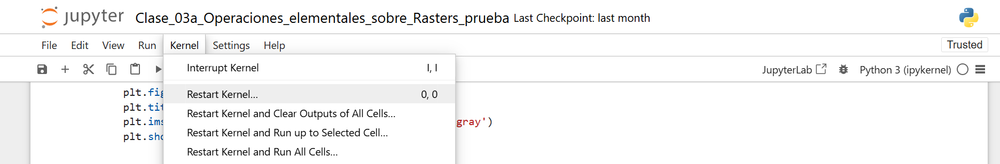


### Ejercicio 1.1 (Opcional):

a) Probar las visualizaciones de cada banda de la imagen SPOT o de la banda 01 de MODIS estirando a distintos rangos porcentuales: 80%, 90% y 95%. Podés ayudarte con la función **scale()**, ya sea que uses la que esta definida acá, o la importes del archivo de funciones.

b) Explorar otras escalas de colores para visualizar cada imagen (hasta ahora venimos usando la escala de grises). En este [enlace](https://matplotlib.org/stable/gallery/color/colormap_reference.html) se pueden consultar algunas de las rampas de color disponibles para MatplotLib.

Número de bandas: 4


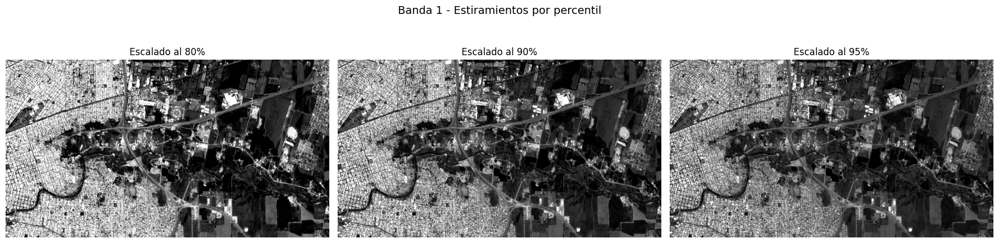

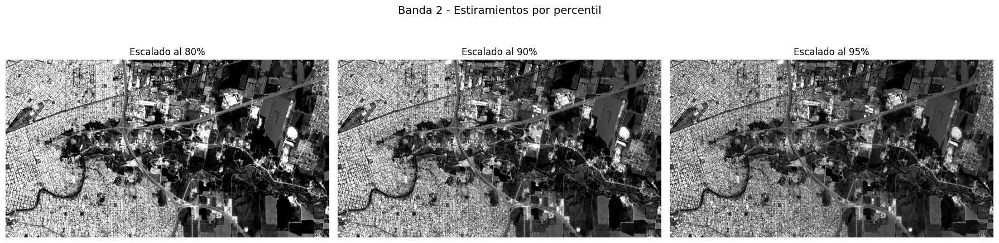

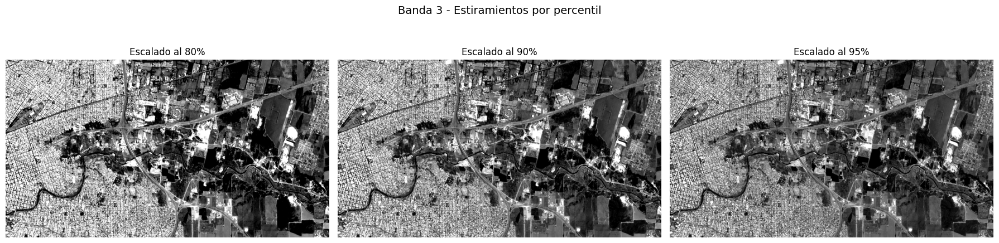

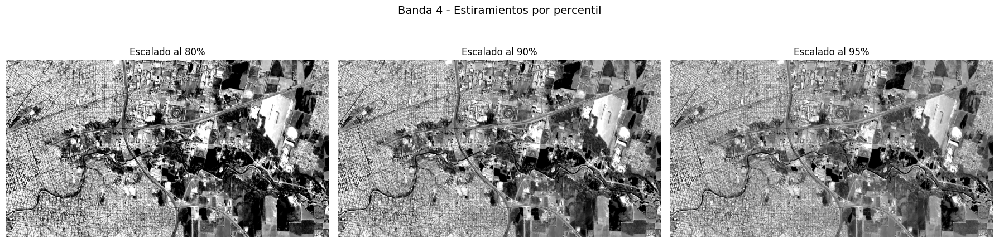

In [28]:
spot_apilada = gdal.Open("./raw_data/SPOT_20170806_MS_p.tif")

n_bandas = spot_apilada.RasterCount
print("Número de bandas:", n_bandas)

percentiles = [10, 5, 2.5]  # Estiramiento al 80%, 90%, 95%
labels = ["80%", "90%", "95%"]


for i in range(1, n_bandas + 1):
    banda = spot_apilada.GetRasterBand(i).ReadAsArray()

    fig, axs = plt.subplots(1, 3, figsize=(18, 5))
    fig.suptitle(f"Banda {i} - Estiramientos por percentil", fontsize=14)

    for j, p in enumerate(percentiles):
        banda_scaled = fn.scale(banda, p=p, nodata=0)
        axs[j].imshow(banda_scaled, cmap='gray')
        axs[j].set_title(f"Escalado al {labels[j]}")
        axs[j].axis('off')

    plt.tight_layout()
    plt.show()

Número de bandas: 4


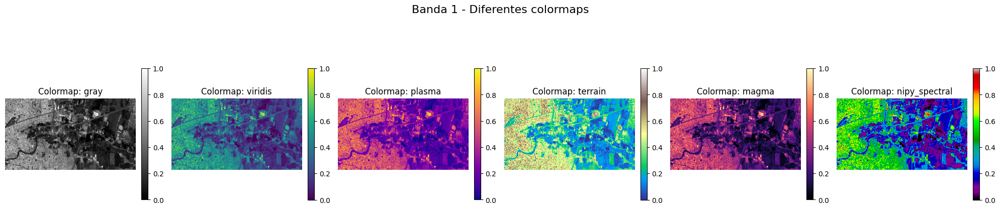

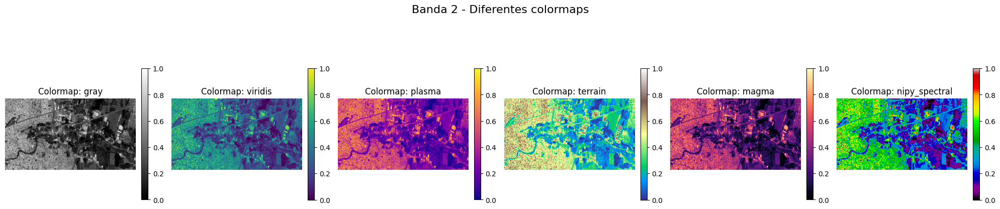

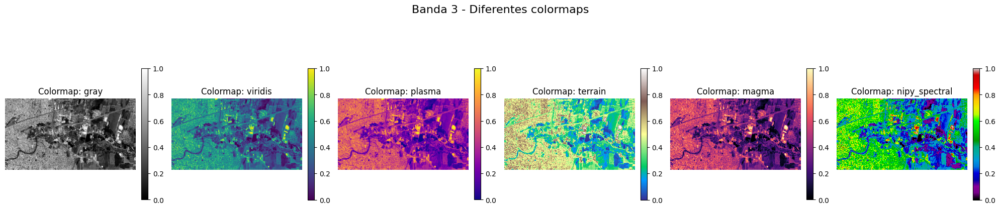

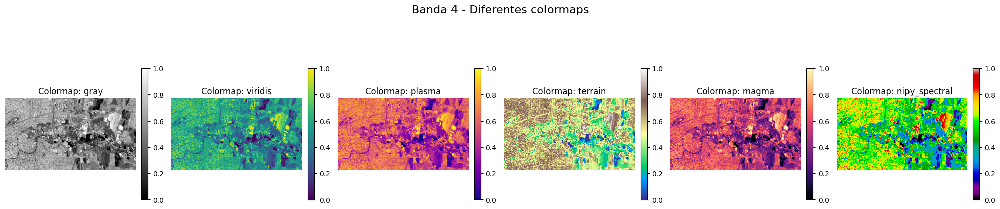

In [30]:
ds = gdal.Open("./raw_data/SPOT_20170806_MS_p.tif")

n_bandas = ds.RasterCount

print("Número de bandas:", n_bandas)


colormaps = ['gray', 'viridis', 'plasma', 'terrain', 'magma', 'nipy_spectral']

for i in range(1, n_bandas + 1):
    
    banda = ds.GetRasterBand(i).ReadAsArray()
    
    banda_scaled = fn.scale(banda, p=2, nodata=0)

    fig, axs = plt.subplots(1, len(colormaps), figsize=(20, 5))
    
    fig.suptitle(f"Banda {i} - Diferentes colormaps", fontsize=16)

    for j, cmap in enumerate(colormaps):
        im = axs[j].imshow(banda_scaled, cmap=cmap)
        axs[j].set_title(f"Colormap: {cmap}")
        axs[j].axis('off')
        plt.colorbar(im, ax=axs[j], fraction=0.046, pad=0.04)

    plt.tight_layout()
    plt.show()

## Visualización de imágenes en RGB

A diferencia de la Clase 02, aquí estamos trabajando con una imagen de 4 bandas. Esto nos permite generar composiciones RGB para hacer visualizaciones en color. Sin embargo, cuando hacemos combinaciones RGB, es necesario escalar primero cada uno de los canales a un mismo rango, para que se puedan visualizar correctamente. Esto lo podemos hacer escalando al máximo y mínimo de una imagen, o tomando sus percentiles como venimos haciendo.
Veamos primero que pasa si no aplicamos ningún escalado. Para generar un RGB, podemos aplicar un _slicing_ sobre la dimensión de las bandas, que es la dimensión 0 en nuestro _array_. Por ejemplo, si queremos armar una combinación RGB usando los canales `[2,1,0]`, podemos hacer `spot_apilada[[2,1,0]]`. Luego, para pasarle esto a `Matplotlib`, tenemos que hacer un cambio de ejes para que nos quede la estructura `(filas,columnas,bandas)`. Esto lo podemos hacer con la función `.transpose()`:

```python
#Formar un RGB usando los canales 2,1,0:
rgb = spot_apilada[[2,1,0]]
print(f"Dimensiones del RGB: {rgb.shape}")

# Transponer los ejes
rgb = rgb.transpose(1,2,0)
print(f"Dimensiones del RGB traspuesto: {rgb.shape}")

plt.figure(figsize = (20,10))
plt.title(f'Combinación 2-1-0', size = 20)
plt.imshow(rgb)
plt.show()
```

Dimensiones del RGB: (3, 989, 1801)
Dimensiones del RGB traspuesto: (989, 1801, 3)


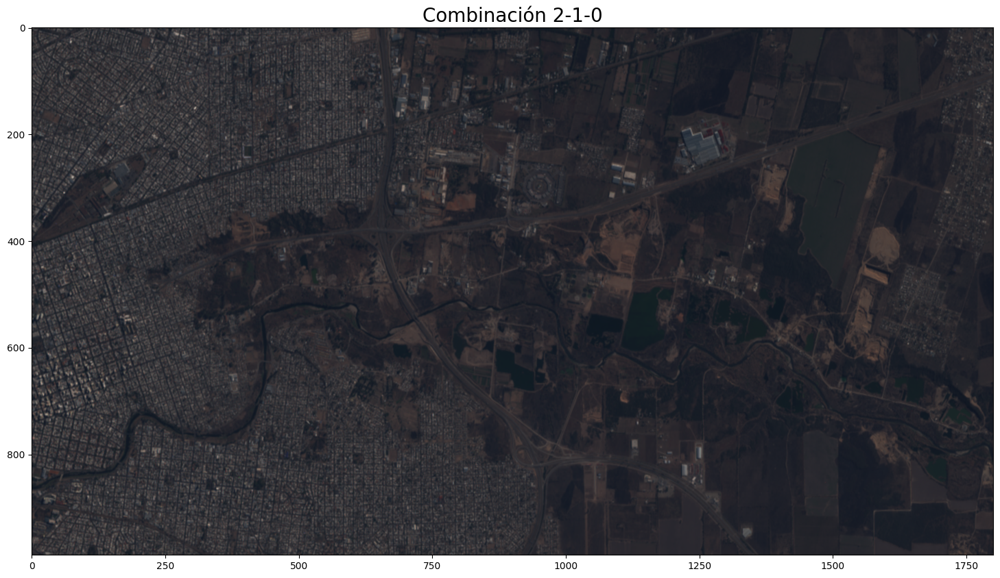

In [38]:
#Formar un RGB usando los canales 2,1,0:
spot_apilada = gdal.Open("./raw_data/SPOT_20170806_MS_p.tif")

spot_apilada = spot_apilada.ReadAsArray()


rgb = spot_apilada[[2,1,0]]
print(f"Dimensiones del RGB: {rgb.shape}")

# Transponer los ejes
rgb = rgb.transpose(1,2,0)
print(f"Dimensiones del RGB traspuesto: {rgb.shape}")

plt.figure(figsize = (20,10))
plt.title(f'Combinación 2-1-0', size = 20)
plt.imshow(rgb)
plt.show()

La imagen se ve algo saturada, y con poco contraste. Probamos qué pasa escalando al mínimo y máximo de cada banda, usando la función scale lo podemos hacer de a una:

```python
#Armamos los array con los que queremos trabajar
r = spot_apilada[2,:,:]
g = spot_apilada[1,:,:]
b = spot_apilada[0,:,:]

#Hacemos el escalado por mínimo y máximo de cada una:
r1 = fn.scale(r)
g1 = fn.scale(g)
b1 = fn.scale(b)

#Las juntamos de nuevo en un solo array
rgb = np.array((r1,g1,b1))
rgb = rgb.transpose(1,2,0)

plt.figure(figsize = (20,10))
plt.title(f'Combinación 2, 1, 0', size = 20)
plt.imshow(rgb)
plt.show()
```

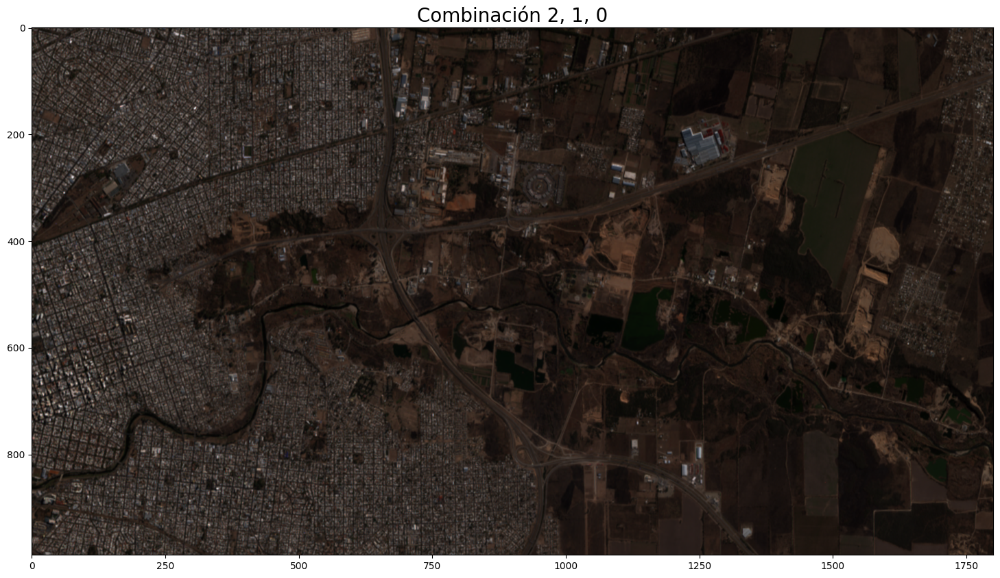

In [39]:
#Armamos los array con los que queremos trabajar
r = spot_apilada[2,:,:]
g = spot_apilada[1,:,:]
b = spot_apilada[0,:,:]

#Hacemos el escalado por mínimo y máximo de cada una:
r1 = fn.scale(r)
g1 = fn.scale(g)
b1 = fn.scale(b)

#Las juntamos de nuevo en un solo array
rgb = np.array((r1,g1,b1))
rgb = rgb.transpose(1,2,0)

plt.figure(figsize = (20,10))
plt.title(f'Combinación 2, 1, 0', size = 20)
plt.imshow(rgb)
plt.show()

La imagen anterior se ve mejor, pero se ve muy oscura, con poco contraste.  Veamos cómo podemos mejorarla, por ejemplo escalando el percentil 2%. Como tenemos bandas escaladas por separado, tenemos que juntarlas en un único _array_, para lo cual podemos usar `np.array()`:

```python
#Armamos los array con los que queremos trabajar
r = spot_apilada[2,:,:]
g = spot_apilada[1,:,:]
b = spot_apilada[0,:,:]

#Hacemos el escalado por mínimo y máximo de cada una:
r1 = fn.scale(r, 2)
g1 = fn.scale(g, 2)
b1 = fn.scale(b, 2)

#Las juntamos de nuevo en un solo array
rgb = np.array((r1,g1,b1))
rgb = rgb.transpose(1,2,0)

plt.figure(figsize = (20,10))
plt.title(f'Combinación 2, 1, 0', size = 20)
plt.imshow(rgb)
plt.show()
```

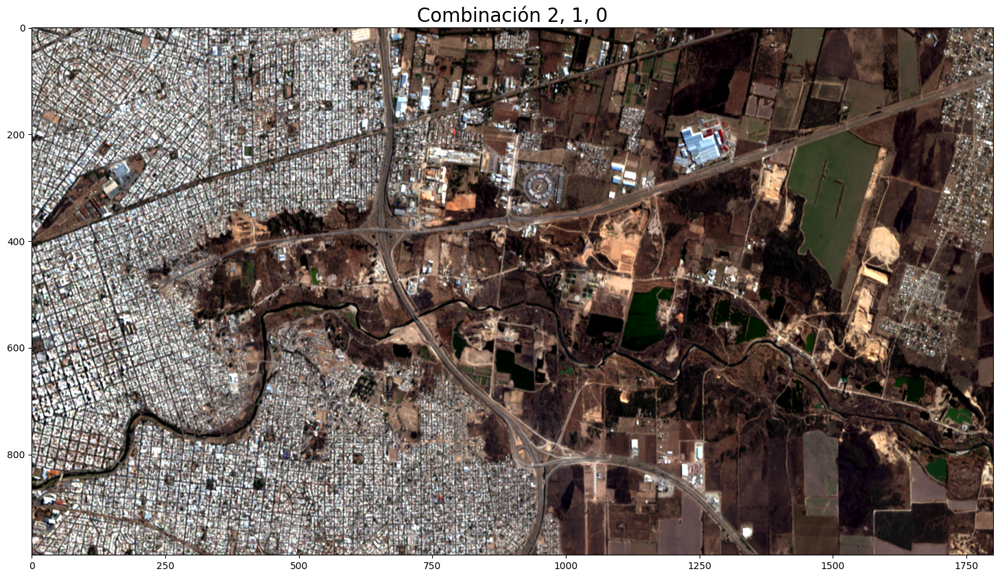

In [40]:
#Armamos los array con los que queremos trabajar
r = spot_apilada[2,:,:]
g = spot_apilada[1,:,:]
b = spot_apilada[0,:,:]

#Hacemos el escalado por mínimo y máximo de cada una:
r1 = fn.scale(r, 2)
g1 = fn.scale(g, 2)
b1 = fn.scale(b, 2)

#Las juntamos de nuevo en un solo array
rgb = np.array((r1,g1,b1))
rgb = rgb.transpose(1,2,0)

plt.figure(figsize = (20,10))
plt.title(f'Combinación 2, 1, 0', size = 20)
plt.imshow(rgb)
plt.show()

¿Y si quisiéramos escalar todas las bandas de la imagen, y luego elegir qué combinación RGB queremos hacer al momento del ploteo? Esto sería un poco más efiiente y nos daría más flexibilidad.  ¿Cómo podríamos indicar que se haga el escalado _para cada banda_? Esto lo solucionamos usando un ciclo de tipo _for_ sobre alguna variable que sea _iterable_.

Repasemos de la Clase 01, ¿qué significa que una variable sea iterable? Quiere decir que podemos _recorrer_ sus elementos uno a uno, y capturar algún valor o atributo de esos elementos en cada iteración o _pasada_. Por ejemplo, si nosotros necesitamos recorrer 4 canales o bandas, podríamos leer ese número haciendo `spot_apilada.shape[0]`, lo cual nos devuelve `4` (`[0]`indica el primer elemento de .shape). Si nosotros sobre ese `4`(o sobre cualquier número) aplicamos la función `range`, obtenemos una secuencia de números del 0 al 3 (excluyendo el 4). Esta secuencia es iterable:

```python
canales = spot_apilada.shape[0]


for i in range(canales):
    # Itera sobre i, asignando los valores de 0 a 3 e
    # imprimiendo su valor seguido un salto de línea
    print(i, '\n')
```

In [41]:
canales = spot_apilada.shape[0]

for i in range(canales):
    # Itera sobre i, asignando los valores de 0 a 3 e
    # imprimiendo su valor seguido un salto de línea
    print(i, '\n')

0 

1 

2 

3 



Entonces, en el código anterior podríamos usar ese `i` para recorrer nuestra imagen `imagen_spot_apilada` a lo largo de su tercera dimensión:

```python
for i in range(canales):
  canal = spot_apilada[:, :, i]
  print(f'Banda o canal {i}, dimensiones: {canal.shape}')
```

In [42]:
for i in range(canales):
  canal = spot_apilada[:, :, i]
  print(f'Banda o canal {i}, dimensiones: {canal.shape}')

Banda o canal 0, dimensiones: (4, 989)
Banda o canal 1, dimensiones: (4, 989)
Banda o canal 2, dimensiones: (4, 989)
Banda o canal 3, dimensiones: (4, 989)


Con ese concepto incorporado, podemos crear un array vacío con la misma estructura que `imagen_spot_apilada` e ir usando el _for_ para escalar cada uno de los canales o bandas y guardarnos en este nuevo array:

```python
# Crear un array vacio con la misma estructura que imagen_spot_apilada. Nos aseguramos que el tipo de dato sea flotante
imagen_escalada = np.empty_like(spot_apilada, dtype=np.float32)

# Definir una variable con el número de canales
canales = imagen_escalada.shape[0]

# Escalar una a una las bandas (usando p=1)
for i in range(canales):
  canal = spot_apilada[i, :, :]
  imagen_escalada[i, :, :] = fn.scale(canal, 2)

print(f'Dimensiones de la imagen escalada: {imagen_escalada.shape}')
```

In [43]:
# Crear un array vacio con la misma estructura que imagen_spot_apilada. Nos aseguramos que el tipo de dato sea flotante
imagen_escalada = np.empty_like(spot_apilada, dtype=np.float32)

# Definir una variable con el número de canales
canales = imagen_escalada.shape[0]

# Escalar una a una las bandas (usando p=1)
for i in range(canales):
  canal = spot_apilada[i, :, :]
  imagen_escalada[i, :, :] = fn.scale(canal, 2)

print(f'Dimensiones de la imagen escalada: {imagen_escalada.shape}')

Dimensiones de la imagen escalada: (4, 989, 1801)


A `Matplotlib` le tenemos que pasar una imagen con estructura `(filas, columnas, bandas)`, eso lo podemos arreglar usando `.transpose()` como ya hicimos antes. Por otro lado, como ahora tenemos todas las bandas, podemos usar el _slicing_ sobre la dimensión correspondiente para formar el RGB que querramos:

```python
# Probar la combinación 2,1,0
r = 2
g = 1
b = 0

plt.figure(figsize = (20,10))
plt.title(f'Combinación {r}, {g}, {b}', size = 20)
plt.imshow(imagen_escalada[[r,g,b]].transpose(1,2,0))
plt.show()

# Probar la combinación 3,2,1
r = 3
g = 2
b = 1

plt.figure(figsize = (20,10))
plt.title(f'Combinación {r}, {g}, {b}', size = 20)
plt.imshow(imagen_escalada[[r,g,b]].transpose(1,2,0))
plt.show()

# Probar la combinación 2,3,1
r = 2
g = 3
b = 1

plt.figure(figsize = (20,10))
plt.title(f'Combinación {r}, {g}, {b}', size = 20)
plt.imshow(imagen_escalada[[r,g,b]].transpose(1,2,0))
plt.show()
```

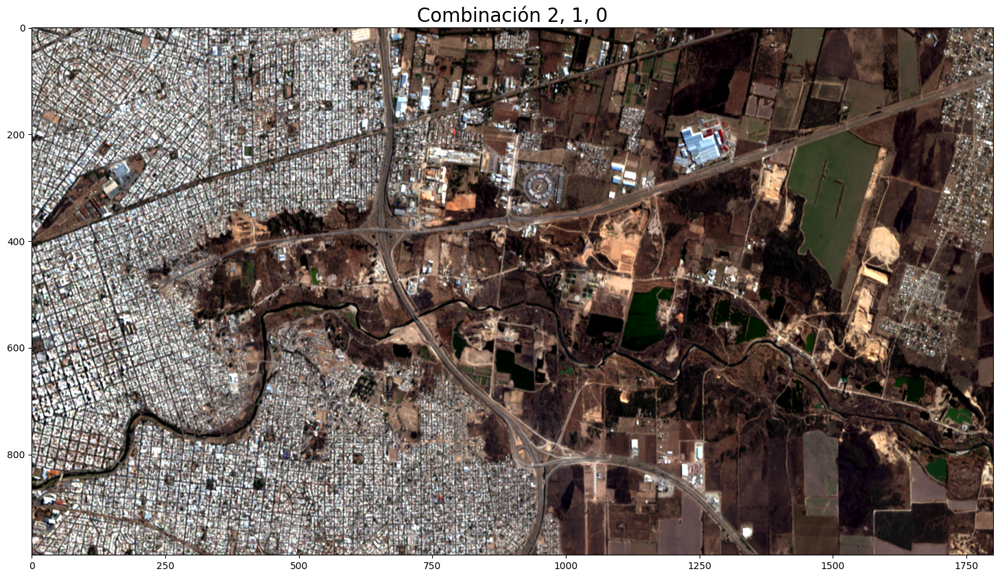

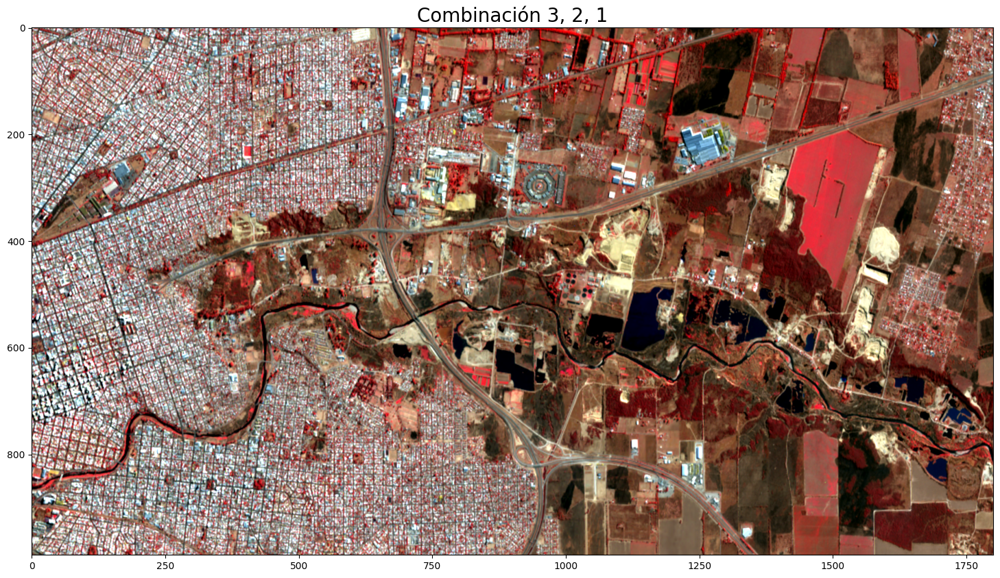

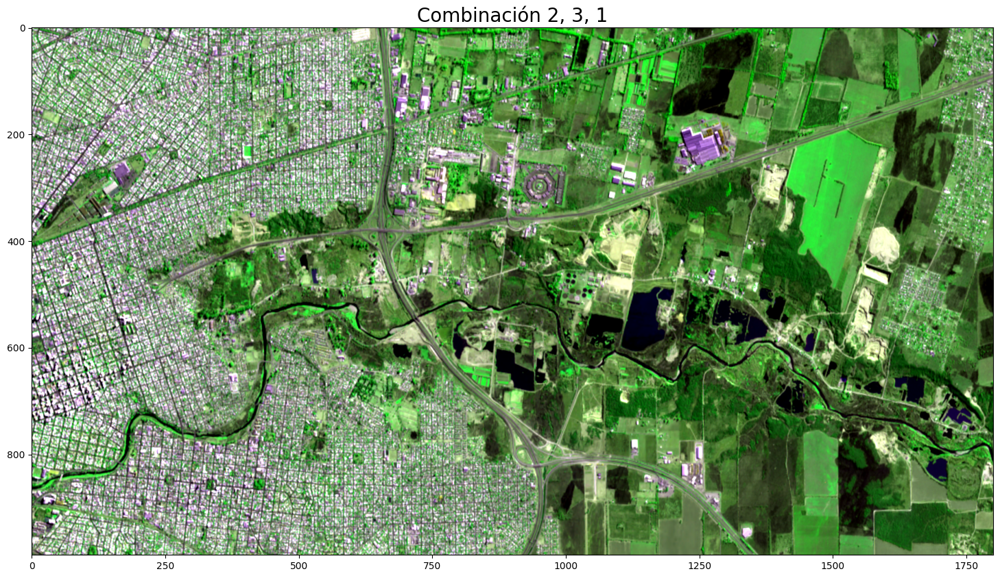

In [44]:
# Probar la combinación 2,1,0
r = 2
g = 1
b = 0

plt.figure(figsize = (20,10))
plt.title(f'Combinación {r}, {g}, {b}', size = 20)
plt.imshow(imagen_escalada[[r,g,b]].transpose(1,2,0))
plt.show()

# Probar la combinación 3,2,1
r = 3
g = 2
b = 1

plt.figure(figsize = (20,10))
plt.title(f'Combinación {r}, {g}, {b}', size = 20)
plt.imshow(imagen_escalada[[r,g,b]].transpose(1,2,0))
plt.show()

# Probar la combinación 2,3,1
r = 2
g = 3
b = 1

plt.figure(figsize = (20,10))
plt.title(f'Combinación {r}, {g}, {b}', size = 20)
plt.imshow(imagen_escalada[[r,g,b]].transpose(1,2,0))
plt.show()

### Ejercicio 1.2:

a) Usando como base la función **scale()** de la Clase 02 (o mejor, la versión corregida que armamos acá), programá una función **scale_multiband** tome como entrada un _array_ multibanda, y el valor de percentil _p_ al cual estirar cada una de las bandas (valor por defecto p = 0), y que devuelva un **stack** scalado. Para hacer el estiramiento en sí, esta función debe llamar a _scale()_. Sin embargo, para la última parte de esta notebook (trabajando con los archivos MODIS de la clase 02), vas a tener que agregar un parámetro adicional que se refiera a cuál es el valor de pixel que debe ser considerado como nodata. Sería algo así:


```python 
def scale_multiband(imagen, p = 0, nodata = None):  
    ...  
    # Definir una variable con el número de canales
    canales = ...

    for i in range(canales):
      canal = ...
      imagen_escalada[i, :, :] = scale(...)
    ...    
    return imagen_escalada
```
    
    
Si te fijas bien en el ejemplo anterior, vas a tener que modificar la función _scale_ para contemplar el valor de _nodata_.    
    
b) **(Opcional)** Programá otra función `plot_rgb()` que tome  como parámetros de entrada la matriz a ser ploteada, una lista de índices correspondientes a las bandas que queremos usar, al que llamaremos `band_list`, en el orden que deben estar (ej: [0,1,2]), y los parámetros _p_ y _nodata_ que son opcionales, y por defecto son 0 y None (los utiliza la función _scale_). La idea es que llame a `scale_multiband()` y luego genere el ploteo con `Matplotlib` usando la combinación de bandas especificada como lista.
    
Guardar ambas funciones ( `scale_multiband()` y `plot_rgb()`) en tu archivo funciones.py.

In [45]:
import importlib
import funciones as fn
importlib.reload(fn)

<module 'funciones' from 'C:\\Users\\pablonicolasr\\Desktop\\pablonicolas\\educacion_formal\\doctorado_ingenieria_uns\\gulich\\gulich_pdis\\funciones.py'>

In [46]:
ds = gdal.Open("./raw_data/SPOT_20170806_MS_p.tif")

n_bandas = ds.RasterCount
alto = ds.RasterYSize
ancho = ds.RasterXSize

spot_array = np.zeros((n_bandas, alto, ancho), dtype="float32")

for i in range(n_bandas):
    spot_array[i, :, :] = ds.GetRasterBand(i + 1).ReadAsArray()

In [47]:
spot_scaled = fn.scale_multiband(spot_array, p=2)

print("Forma:", spot_scaled.shape)
print("Min (global):", np.nanmin(spot_scaled))
print("Max (global):", np.nanmax(spot_scaled))

Forma: (4, 989, 1801)
Min (global): 0.0
Max (global): 1.0


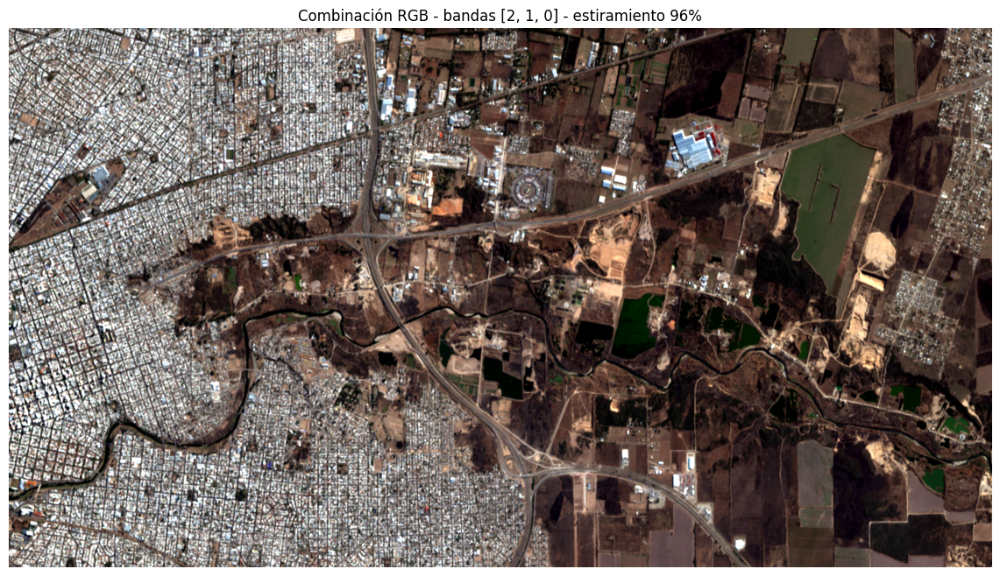

In [48]:
fn.plot_rgb(spot_array, band_list=[2, 1, 0], p=2)

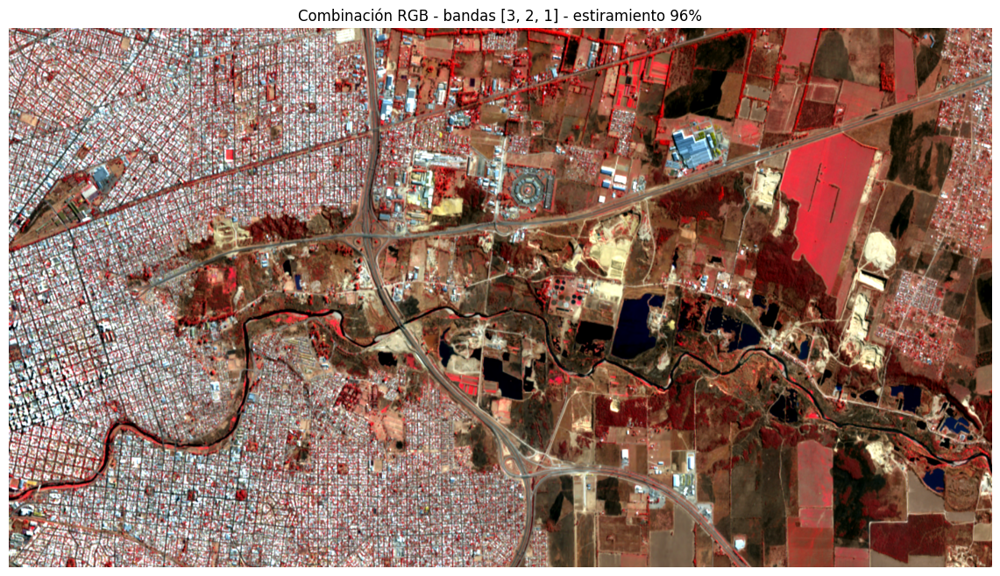

In [49]:
fn.plot_rgb(spot_array, band_list=[3, 2, 1], p=2)

## 2) Operaciones básicas: Subsets y álgebra de bandas

Ahora que hemos leido nuestra imagen y hemos logrado visualizarla, realizaremos algunas operaciones básicas entre sus bandas.

1) En primer lugar haremos algunos recortes simples sobre la misma  
2) Luego, realizaremos operaciones entre las bandas, como la obtención de índices, y veremos como guardar los resultados a un nuevo archivo.

In [50]:
spot_apilada = gdal.Open("./raw_data/SPOT_20170806_MS_p.tif")

spot_apilada = spot_apilada.ReadAsArray()

#### Recortes simples sobre la imagen

En esta seccion aprenderemos como obtener recortes (subsets) rectangulares de la imagen, haciendo uso del _slicing_ que nos ofrece Numpy. Esto es una alternativa a lo que aprendimos en la clase 2, donde el recorte lo definimos desde el mismo método ReadAsArray().

Cuando hagamos la Clase 04, veremos que hay formas más adecuadas para los datos geoespaciales, utilizando archivos vectoriales externos con georreferenciación. Supongamos que queremos recortar la imagen aproximadamente al área demarcada en la SPOT:

<!-- ![spotRecorte.png](attachment:spotRecorte.png) -->

<p align="left">
 <img src="../images/spotRecorte.png" width="500" >
</p>

Dicho sector va (aproximadamente) de la columna 750 a la 1500, y de la fila 200 hasta la 800. Sobre la variable **spot_apilada** aplicaremos el subset, teniendo cuidado de la indexación en Python (recuerden que siempre inicia desde 0 a la hora de hacer el _slicing_).

```python
spot_apilada_rec = spot_apilada[:,199:799,749:1499]
spot_apilada_rec.shape
```

In [51]:
spot_apilada_rec = spot_apilada[:,199:799,749:1499]
spot_apilada_rec.shape

(4, 600, 750)

La nueva matriz recortada parece tener las dimensiones correctas. Visualicemos el resultado del recorte en RGB con _matplotlib_ . Usamos la función que definimos al final de la otra sección. **No te preocupes si al llegar a esta parte todavía no la pudiste generar, en la próxima Clase te la pasamos :)**

```python
fn.plot_rgb(spot_apilada_rec, [2,1,1], p=2, figsize = (20,10) )
```

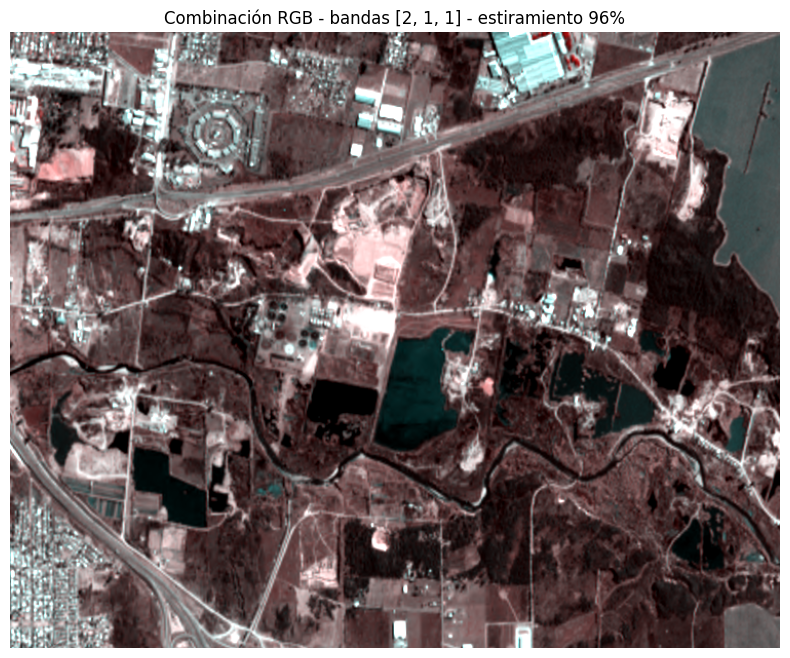

In [54]:
fn.plot_rgb(spot_apilada_rec, [2,1,1], p=2)

### Ejercicio 2.1 (Opcional): 

a) Realizar recortes de otra/s zonas para ejercitar el _slicing_ sobre arreglos de Numpy. Pueden probar distintos tipos de superficies, pues en esta imagen tenemos paisajes muy heterogéneos.

b) Construyan los histogramas para esos recortes y compárenlos con la imagen completa, para todas o alguna de las bandas de la imagen. Esto les servirá para familiarizarse con actividades que haremos en la Clases 04 y 05.

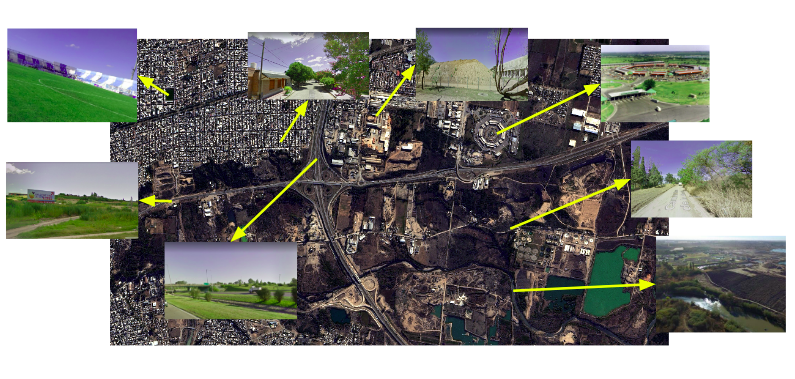

### Ejercicio 2.2 (Opcional)

Retomando la función **subset_img** que se les propuso generar en la Clase 02. ¿Se animan realizar alguno de los recortes anteriores a partir de las coordenadas superior izquierda e inferior derecha? **Ayuda**: Podés sacar tus coordenadas superior izquierda e inferior derecha mirando en QGIS. 

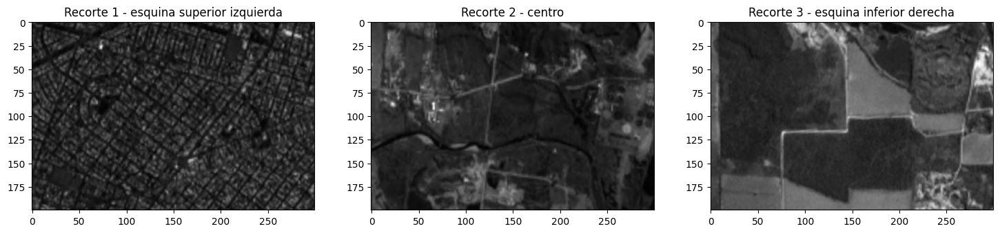

In [73]:
# Ejercicio 2.1
ds = gdal.Open("./raw_data/SPOT_20170806_MS_p.tif")

banda1 = ds.GetRasterBand(1).ReadAsArray()

recorte1 = banda1[0:200, 0:300]

center_row = banda1.shape[0] // 2
center_col = banda1.shape[1] // 2
recorte2 = banda1[center_row-100:center_row+100, center_col-150:center_col+150]

recorte3 = banda1[-200:, -300:]


fig, axs = plt.subplots(1,3, figsize=(18,6))

axs[0].imshow(recorte1, cmap='gray')
axs[0].set_title("Recorte 1 - esquina superior izquierda")

axs[1].imshow(recorte2, cmap='gray')
axs[1].set_title("Recorte 2 - centro")

axs[2].imshow(recorte3, cmap='gray')
axs[2].set_title("Recorte 3 - esquina inferior derecha")

plt.show()

In [55]:
# Ejercicio 2.2
import funciones as fn
import importlib
importlib.reload(fn)

<module 'funciones' from 'C:\\Users\\pablonicolasr\\Desktop\\pablonicolas\\educacion_formal\\doctorado_ingenieria_uns\\gulich\\gulich_pdis\\funciones.py'>

In [58]:
import xml.etree.ElementTree as ET

tree = ET.parse("./raw_data/DIM_SPOT7_MS_201708061354452_ORT_C0000000072330.XML")
root = tree.getroot()

def buscar(tagname):
    for elem in root.iter():
        if tagname in elem.tag.upper():
            return float(elem.text)
    return None
    
ULX = buscar("ULXMAP")
ULY = buscar("ULYMAP")
XDIM = buscar("XDIM")
YDIM = buscar("YDIM")

if None in (ULX, ULY, XDIM, YDIM):
    raise ValueError("Faltan elementos en el XML")

geotransform = (ULX, XDIM, 0.0, ULY, 0.0, -abs(YDIM))

In [71]:
spot_apilada = gdal.Open("./raw_data/SPOT_20170806_MS_p.tif")

gt = spot_apilada.GetGeoTransform()
ncols = spot_apilada.RasterXSize
nrows = spot_apilada.RasterYSize

ULX = gt[0]
ULY = gt[3]
XDIM = gt[1]
YDIM = gt[5]

LRX = ULX + ncols * XDIM
LRY = ULY + nrows * YDIM

print(f"Bounding Box real raster:")
print(f"UL=({ULX}, {ULY})")
print(f"LR=({LRX}, {LRY})")


ul_x = ULX + 1000
ul_y = ULY - 1000 
lr_x = ULX + 4000
lr_y = ULY - 4000

subset = fn.subset_img(spot_apilada, ul_x, ul_y, lr_x, lr_y)

Bounding Box real raster:
UL=(388866.0, 6528056.0)
LR=(399672.0, 6522122.0)


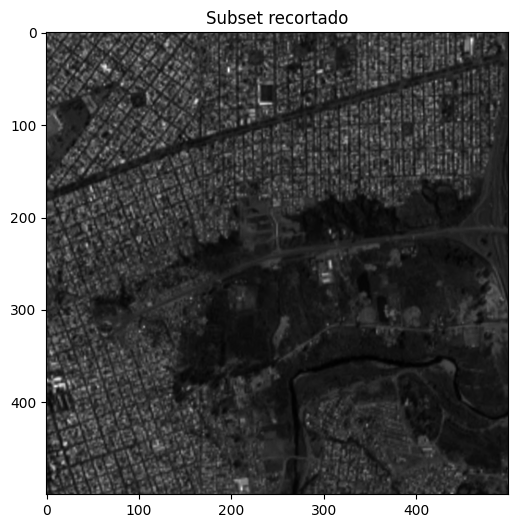

In [72]:
plt.figure(figsize=(10,6))
plt.imshow(subset, cmap='gray')
plt.title("Subset recortado")
plt.show()

#### Álgebra de bandas

A continuación vamos a hacer algunas operaciones con las bandas del recorte realizado (nuestra variable **spot_apilada_rec**) para obtener nuevos productos. Al ser arreglos de Numpy, se pueden realizar operaciones matemáticas con la mismas y entre ellas también (sumarlas, multiplacarlas, restarlas, dividirlas, normalizarlas por una constante, etc). 

Aprovecharemos estas capacidades para calcular dos índices normalizados que de gran uso en la Teledetección Óptica: El Índice de Vegetación Normalizado (o _NDVI_ por sus siglas en inglés), y el Índice de Agua Normalizado (o _NDWI_ por sus siglas en inglés), que trabajarán ustedes en un ejercicio:

$ NDVI = \frac{NIR - R}{NIR + R} $  

Donde $NIR$ se refiere a la banda del Infrarrojo Cercano, y $R$ se refiere a la banda del Rojo (¿Cuáles serían en nuestra SPOT?).

```python
#Cálculo  y visualización del NDVI

# Tip: Recordar que se pueden consultar distintas paletas de color de matplotlib aquí: https://matplotlib.org/stable/tutorials/colors/colormaps.html

b_nir = spot_apilada_rec[3,:,:].astype(np.float32)
b_red = spot_apilada_rec[2,:,:].astype(np.float32)

ndvi = (b_nir - b_red) / (b_nir + b_red)

plt.figure(figsize = (12,6))
plt.imshow(ndvi, vmin = 0, vmax = 0.75, cmap = 'gray')
plt.title("NDVI")
plt.show()
```

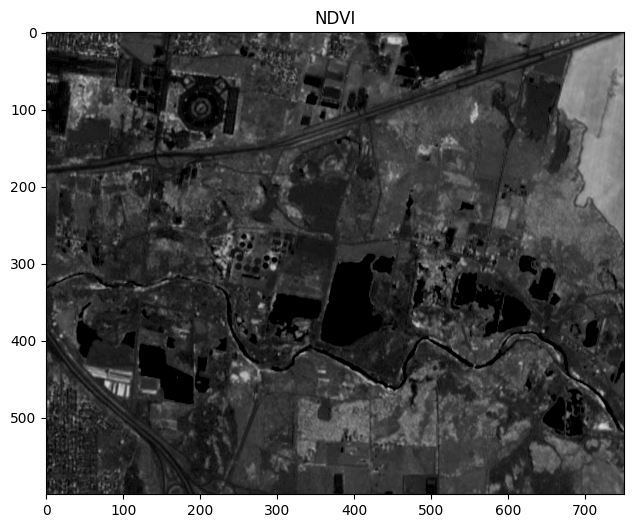

In [75]:
b_nir = spot_apilada_rec[3,:,:].astype(np.float32)
b_red = spot_apilada_rec[2,:,:].astype(np.float32)

ndvi = (b_nir - b_red) / (b_nir + b_red)

plt.figure(figsize = (12,6))
plt.imshow(ndvi, vmin = 0, vmax = 0.75, cmap = 'gray')
plt.title("NDVI")
plt.show()

Probemos con otra paleta de color, aplicándole la función scale() al NDVI:

```python
fig,ax = plt.subplots(figsize = (12,6))
ax.imshow(ndvi, vmin = 0, vmax = 0.75, cmap = 'Greens')
ax.set_title("NDVI")
plt.show()
```

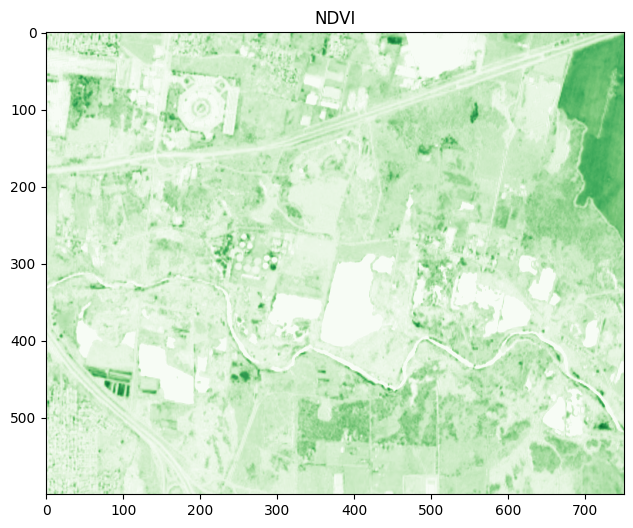

In [76]:
fig,ax = plt.subplots(figsize = (12,6))
ax.imshow(ndvi, vmin = 0, vmax = 0.75, cmap = 'Greens')
ax.set_title("NDVI")
plt.show()

### Ejercicio 2.3:

Repetir los pasos realizados con el NDVI, para calcular el Ìndice Normalizado de Agua (o NDWI) según la siguiente fórmula:

$ NDWI = \frac{G - NIR}{G + NIR} $ 

Donde $ G $ corresponde a la banda del verde, y $NIR$ es la misma que utilizamos para el NDVI

**Nota**: La fórmula propuesta para el NDWI corresponde a la formulación de [Mc. Feeters (1996)](https://hess.copernicus.org/articles/22/4349/2018/hess-22-4349-2018-t01.pdf)

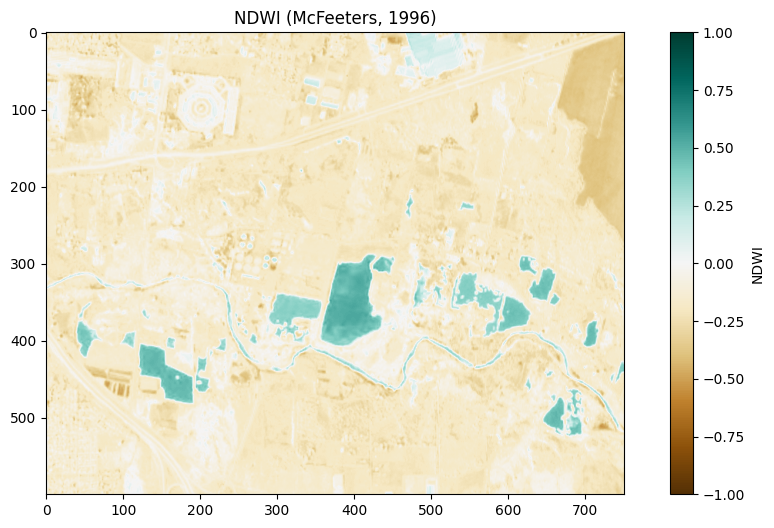

In [77]:
b_green = spot_apilada_rec[1,:,:].astype(np.float32)  # Banda del verde (Banda 2)
b_nir   = spot_apilada_rec[3,:,:].astype(np.float32)  # Banda NIR (Banda 4)

# Calculamos NDWI
ndwi = (b_green - b_nir) / (b_green + b_nir + 1e-6) 

plt.figure(figsize=(12,6))
plt.imshow(ndwi, vmin=-1, vmax=1, cmap="BrBG")
plt.colorbar(label="NDWI")
plt.title("NDWI (McFeeters, 1996)")
plt.show()

## 3) Escritura de archivos recortados

Ahora que tenemos recortados nuestros archivos y que hemos generado algunos productos nuevos, veamos como guardarlos en nuestro equipo. 

Hay algunas cuestiones a considerar, como ser:

- La proyección de nuestro archivo, que capturamos al principio de la notebook en la variable _src_
- En qué formato vamos a querer guardar nuestro raster
- El tipo de dato del archivo que queremos guardar (principalmente si será un raster con números enteros o flotantes).
- Las **dimensiones** del archivo que queremos guardar: Recordar que ahora estamos almacenando un recorte de nuestra imagen orginal.
- La geotransformación o _geotransform_ , que hemos leido al principio de la notebook en la variable _gt_ ,pero que ahora deberemos adaptar a nuestro recorte.

Empecemos por revisar este último parámetro, para lo cual retomaremos algunas cosas de la Clase 02

```python
print(gt)
```

In [78]:
print(gt)

(388866.0, 6.0, 0.0, 6528056.0, 0.0, -6.0)


¿Qué era cada uno de los parámetros que contiene el GeoTransform?:

1) La coordenada superior izquierda en el eje X  
2) Ancho del pixel en X (Este-Oeste)  
3) La rotación de las filas (normalmente esta es 0)  
4) La coordenada superior izquierda en el eje Y  
5) La rotación de las columnas (normalmente esta es 0)  
6) Ancho del pixel en Y (Norte-Sur): En el caso de las imágenes que trabajamos nostros, que apuntan hacia el norte, este siempre toma un valor negativo.  

Nuestro recorte comparte casi todos los atributos del parámetro _Geotransform()_ con la imagen original, excepto el 1) y el 4). Efectivamente, la esquina superior izquierda de nuestro recorte no es el mismo, y de alguna manera tenemos que poder recalcularlas.

Nosotros hicimos el recorte de la SPOT con el siguiente código:

    spot_apilada[:,199:799,749:1499]

Es decir que la esquina superior izquierda estaría ubicada en la fila 199, columna 749:

<p align="left">
 <img src="../images/recorteUL.png" width="500" >
</p>

Sabiendo eso, como vimos en la Clase 02 podemos calcular el desplazamiento en coordenadas que necesitamos para llegar a nuestro nuevo punto superior izquierdo. En el caso de la coordenada X, debemos tomar el índice columnas (749) y el ancho del pixel en X, y sumarle la coordenada original:

```python
gt[1]*749 + gt[0]
```

In [79]:
gt[1]*749 + gt[0]

393360.0

En el caso de Y, debemos proceder de manera similar, con el índice de filas (199) y el ancho del pixel en Y (respetando su signo!!!):

```python
gt[5]*199 + gt[3]
```

In [80]:
gt[5]*199 + gt[3]

6526862.0

Ahora podemos crearnos nuestro nuevo _Geotransform()_ para el recorte, porque ya conocemos las coordenadas de su esquina superior izquierda. Como **gt** es una tupla, podemos re-armarla manualmente siempre y cuando respetemos el orden y la estructura original. Reutilizaremos todos los elementos de **gt** , salvo los que hemos calculado, y con es construiremos una variable nueva que se llame **gt_recorte**:

```python
ulx = gt[1]*749 + gt[0]
uly = gt[5]*199 + gt[3]

gt_recorte = (ulx, gt[1], gt[2], uly, gt[4], gt[5])

print(gt_recorte)
```

In [81]:
ulx = gt[1]*749 + gt[0]
uly = gt[5]*199 + gt[3]

gt_recorte = (ulx, gt[1], gt[2], uly, gt[4], gt[5])

print(gt_recorte)

(393360.0, 6.0, 0.0, 6526862.0, 0.0, -6.0)


Otra propiedad que debemos especificar es el Sistema de Coordenadas del raster que almacenaremos. Para facilitar las cosas, seguiremos usando el mismo de la imagen original, que fue leido al principio de la notebook como **src**:

```python
print(src)
```

In [82]:
print(src)

PROJCS["WGS 84 / UTM zone 20S",GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4326"]],PROJECTION["Transverse_Mercator"],PARAMETER["latitude_of_origin",0],PARAMETER["central_meridian",-63],PARAMETER["scale_factor",0.9996],PARAMETER["false_easting",500000],PARAMETER["false_northing",10000000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH],AUTHORITY["EPSG","32720"]]


A continuación, veamos las dimensiones (filas y columnas) de nuestro recorte. Esto lo podemos obtener con el método _.shape()_ y guardarlo a variables:

```python
print('Dimensiones del recorte:', spot_apilada_rec.shape)

filas = spot_apilada_rec.shape[1]
columnas = spot_apilada_rec.shape[2]

print('Filas, Columnas:', filas, columnas)
```

In [83]:
print('Dimensiones del recorte:', spot_apilada_rec.shape)

filas = spot_apilada_rec.shape[1]
columnas = spot_apilada_rec.shape[2]

print('Filas, Columnas:', filas, columnas)

Dimensiones del recorte: (4, 600, 750)
Filas, Columnas: 600 750


También debemos saber en qué formato querremos nuestra imagen de salida. En la librería GDAL esto se conoce como _driver_. GDAL trabaja con una gran variedad de Drivers que pueden consultarse [aquí](https://gdal.org/drivers/raster/index.html). Nosotros en particular trabajaremos con GeoTiff, y la forma de indicarle a GDAL que queremos ese formato es con el método _GetDriverByName()_:

```python
driver = gdal.GetDriverByName('GTiff')
driver
```


In [84]:
driver = gdal.GetDriverByName('GTiff')
driver

<osgeo.gdal.Driver; proxy of <Swig Object of type 'GDALDriverShadow *' at 0x000001FA3A4A0A20> >

Por último, nos queda elegir el tipo de dato que queremos para nuestros píxeles. GDAL define codificaciones para los distintos tipos de datos. Algunos de los más usados se listan a continuación:

- GDT_CFloat32: Dato complejo flotante de 32 bits
- GDT_CFloat64: Dato complejo flotante de 64 bits
- GDT_CInt16: Dato complejo entero de 16 bits
- GDT_CInt32: Dato complejo entero de 32 bits
- GDT_Float32: Dato flotante de 32 bits
- GDT_Float64: Dato flotante de 64 bits
- GDT_Int16: Dato entero de 16 bits (con signo, admite positivos y negativos)
- GDT_Int32: Dato entero de 32 bits (con signo, admite positivos y negativos)
- GDT_Byte: Dato entero natural de 8 bits
- GDT_UInt16: Dato entero de 16 bits (sin signo, solo positivos)
- GDT_UInt32: Dato entero de 32 bits (sin signo, solo positivos)

Si abrimos por ejemplo la imagen SPOT en QGIS, o simplemente ploteamos sus valores, veremos que se tratan de valores flotantes. De hecho , al mirar las propiedades del raster en QGIS, constatamos que el tipo de dato es **Float32**:

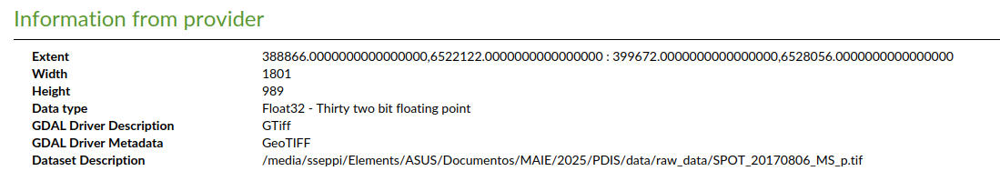

**Por lo tanto, a GDAL le indicaremos que trabajamos con GDT_Float32**

La siguiente celda combina todo los parámetros que creamos o calculamos y escribe el raster de salida. Vamos a guardar la matriz **spot_apilada_rec** como archivo geotiff, conservando sus 4 bandas. Asegúrense de guardar todos los resultados finales en la carpeta **data/out**

```python
bandas = 4 
imagen_salida = driver.Create('../data/out/spot_apilada_rec.tif', columnas, filas, bandas, gdal.GDT_Float32)
```

In [85]:
bandas = 4 
imagen_salida = driver.Create('./out/spot_apilada_rec.tif', columnas, filas, bandas, gdal.GDT_Float32)

Esto crea simplemente un archivo vacio, en este caso en el directorio de nuestra Notebook, al que deberemos cargarle datos. La estructura genérica de esta orden se resumen en la siguiente imagen de ejemplo:

<p align="left">
 <img src="../images/driverCreate.png">
</p>

Ahora, le asignamos el sistema de coordenadas y el GeoTransform a **imagen_salida**:

```python
imagen_salida.SetProjection(src)
imagen_salida.SetGeoTransform(gt_recorte)

#Corroboramos  que se haya asignado correctamente
imagen_salida.GetGeoTransform()
```

In [86]:
imagen_salida.SetProjection(src)
imagen_salida.SetGeoTransform(gt_recorte)

#Corroboramos  que se haya asignado correctamente
imagen_salida.GetGeoTransform()

(393360.0, 6.0, 0.0, 6526862.0, 0.0, -6.0)

Ahora tomamos cada una de las bandas de nuestro archivo de salida, y le "cargamos" cada una de las bandas de **spot_apilada_rec**:

```python
#Banda 1
imagen_salida.GetRasterBand(1).WriteArray(spot_apilada_rec[0])
#Banda 2
imagen_salida.GetRasterBand(2).WriteArray(spot_apilada_rec[1,:,:])
#Banda 3
imagen_salida.GetRasterBand(3).WriteArray(spot_apilada_rec[2,:,:])
#Banda 4
imagen_salida.GetRasterBand(4).WriteArray(spot_apilada_rec[3,:,:])

#Liberamos el archivo con el comando del. De esa forma se termina de escribir.

del imagen_salida
```

In [87]:
imagen_salida.GetRasterBand(1).WriteArray(spot_apilada_rec[0])
#Banda 2
imagen_salida.GetRasterBand(2).WriteArray(spot_apilada_rec[1,:,:])
#Banda 3
imagen_salida.GetRasterBand(3).WriteArray(spot_apilada_rec[2,:,:])
#Banda 4
imagen_salida.GetRasterBand(4).WriteArray(spot_apilada_rec[3,:,:])

#Liberamos el archivo con el comando del. De esa forma se termina de escribir.

del imagen_salida

#### Resumiendo un poco:

En esta sección hemos visto cómo escribir un raster usando los métodos que nos ofrece GDAL, y hemos jugado un poco con los datos para adaptar el parámetro _GeoTransform()_ al recorte que hicimos de la imagen original. En la Clase 04 vamos a ver que esto se puede hacer de manera mucho más directa, pero ver al menos una vez cómo funcionan por detrás estas variables puede servir para asentar ideas y conceptos.

Dejamos a continuación un ejemplo de función que guarda una matriz como archivo raster usando las funciones de GDAL, debiendo ustedes darle como parámetros:

- La matriz a guarda
- La ruta donde guardarlo
- El nombre del archivo de salida
- El driver (por ejemplo 'GTiff')
- El tipo de datos (por ejemplo gdal.GDT_Float32)
- El GeoTransform
- El SRC
- El número de bandas

Pueden probarla, y agregarla a su archivo **funciones.py**


Les dejamos como ejemplo el siguiente codigo. Pero atención a la estructura que pide como entrada. La salida que nos da **dstack** que usamos para los RGB no va a servir. ¿Qué pasa si probamos apilar las bandas con **stack**?

```python
def write_raster_gdal(a, path, fname, fdriver, dtype, gt, src):
    '''
    Esta función está pensada para arreglos o matrices de 2 o 3 dimensiones, donde:
    Para 3 dimensiones:
    a.shape[0] = Numero de bandas
    a.shape[1] = Numero de filas
    a.shape[2] = Numero de columnas

    Para 2 dimensiones:
    a.shape[0] = Numero de filas
    a.shape[1] = Numero de columnas
    '''
    import os
    shape = a.shape
    driver  = gdal.GetDriverByName(fdriver)
    if len(a.shape) == 2:
        nband = 1
        out_image = driver.Create(os.path.join(path,fname ),shape[1],shape[0],nband,dtype)
        out_image.GetRasterBand(1).WriteArray(a)
    else:
        nband = shape[0]
        out_image = driver.Create(os.path.join(path,fname ),shape[2],shape[1],nband,dtype)
        for i in range(nband):
            out_image.GetRasterBand(i+1).WriteArray(a[i,:,:])
        
    out_image.SetGeoTransform(gt)
    out_image.SetProjection(src)
    
    del out_image

#Celda de prueba
write_raster_gdal(spot_apilada_rec, '../data/out', 'spot_apilada_rec.tif', 'GTiff', gdal.GDT_Float32, gt_recorte, src)
```


In [88]:
import funciones as fn
import importlib
importlib.reload(fn)

<module 'funciones' from 'C:\\Users\\pablonicolasr\\Desktop\\pablonicolas\\educacion_formal\\doctorado_ingenieria_uns\\gulich\\gulich_pdis\\funciones.py'>

In [90]:
fn.write_raster_gdal(spot_apilada_rec, './out', 'spot_apilada_rec.tif', 'GTiff', gdal.GDT_Float32, gt_recorte, src)

### Ejercicio 3.1

Repetir los pasos para la escritura del recorte, con los índices NDVI y NDWI calculados en la sección anterior.
Probar dos alternativas:

a) Guardar cada uno de los índices como archivos separados. Nombralos como **../data/out/spot_apilada_rec_ndvi.tif** y **../data/out/spot_apilada_rec_ndwi.tif** respectivamente. Podés utilizar la función **write_raster_gdal()** que definimos en la celda anterior.

b) Generar un raster que contenga las 4 bandas multiespectrales, el NDVI y el NDWI (en ese orden), y guardarlo como **../data/out/spot_apilada_rec_indices.tif**. Podés utilizar la función **write_raster_gdal()** que definimos en la celda anterior. Previamente, vas a tener que apilar todas las bandas en un único _stack_.

In [92]:
fn.write_raster_gdal(
    a = ndvi,
    path = "./out/",
    fname = "spot_apilada_rec_ndvi.tif",
    fdriver = "GTiff",
    dtype = gdal.GDT_Float32,
    gt = gt,
    src = src
)

In [94]:
fn.write_raster_gdal(
    a = ndwi,
    path = "./out/",
    fname = "spot_apilada_rec_ndwi.tif",
    fdriver = "GTiff",
    dtype = gdal.GDT_Float32,
    gt = gt,
    src = src
)

### Un extra final: ¿Qué sucede cuando remuestreamos la imagen?

Supongamos que volvemos a leer el archivo que guardamos recién, _'spot_apilada_rec.tif'_ pero le aplicamos un remuestreo. Por ejemplo, reducimos su tamaño a la mitad. En tal caso, podemos retomar lo apendido en la Clase 02, donde al método `ReadAsArray` le pasamos los valores correspondientes en los parámetros `buf_xsize` y `buf_ysize`

```python
ds_apilado = gdal.Open('../data/out/spot_apilada_rec.tif')

ds_remuestreado = ds_apilado.ReadAsArray(buf_xsize=ds_apilado.RasterXSize//2,
                                       buf_ysize=ds_apilado.RasterYSize//2,
                                       resample_alg=1)
bandas, filas, columnas = ds_remuestreado.shape
print("Dimensiones del array remuestreado:", bandas, filas, columnas) 
```

Observar que en este caso, usamos `resample_alg=1`, eso corresponde al método de [Interpolación Bilineal](https://gisgeography.com/bilinear-interpolation-resampling/).

In [95]:
ds_apilado = gdal.Open('./out/spot_apilada_rec.tif')

ds_remuestreado = ds_apilado.ReadAsArray(buf_xsize=ds_apilado.RasterXSize//2,
                                       buf_ysize=ds_apilado.RasterYSize//2,
                                       resample_alg=1)
bandas, filas, columnas = ds_remuestreado.shape
print("Dimensiones del array remuestreado:", bandas, filas, columnas)

Dimensiones del array remuestreado: 4 300 375


Si queremos gurdar esta imagen, debemos hacer un cambio en su _geotransform_. En este caso, en los elementos que se refieren al tamaño de píxel en X y en Y:

```python
src = ds_apilado.GetProjection()
gt_apilado = ds_apilado.GetGeoTransform()
gt_remuestreado = (gt_apilado[0], gt_apilado[1]*2, gt_apilado[2], gt_apilado[3], gt_apilado[4], gt_apilado[5]*2)

print("Geotransform original: ", gt_apilado)
print("Geotransform del remuestreado: ", gt_remuestreado)
```

In [96]:
src = ds_apilado.GetProjection()
gt_apilado = ds_apilado.GetGeoTransform()
gt_remuestreado = (gt_apilado[0], gt_apilado[1]*2, gt_apilado[2], gt_apilado[3], gt_apilado[4], gt_apilado[5]*2)

print("Geotransform original: ", gt_apilado)
print("Geotransform del remuestreado: ", gt_remuestreado)

Geotransform original:  (393360.0, 6.0, 0.0, 6526862.0, 0.0, -6.0)
Geotransform del remuestreado:  (393360.0, 12.0, 0.0, 6526862.0, 0.0, -12.0)


Finalmente, podemos guardar nuestro raster remuestreado usando la función `write_raster_gdal`:

```python
# Guardamos el raster remuestreado usando la función:
write_raster_gdal(ds_remuestreado, '../data/out', 'spot_apilada_rec_resample.tif', 'GTiff', gdal.GDT_Float32, gt_remuestreado, src)
```

In [97]:
fn.write_raster_gdal(ds_remuestreado, './out/', 'spot_apilada_rec_resample.tif', 'GTiff', gdal.GDT_Float32, gt_remuestreado, src)